<a href="https://colab.research.google.com/github/hvkchaitanya7/grp3capstoneprj/blob/main/ImageCaptionGroup3_Attention_Resnet50.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Reference (GitHub):- https://github.com/hlamba28/Automatic-Image-Captioning/blob/master/Automatic%20Image%20Captioning.ipynb

In [ ]:
!rm -rf Flickr8k_Dataset.zip
!rm -rf Flickr8k_text.zip
!wget https://github.com/jbrownlee/Datasets/releases/download/Flickr8k/Flickr8k_Dataset.zip -O Flickr8k_Dataset.zip
!wget https://github.com/jbrownlee/Datasets/releases/download/Flickr8k/Flickr8k_text.zip -O Flickr8k_text.zip
!unzip Flickr8k_Dataset.zip
!unzip Flickr8k_text.zip

Streaming output truncated to the last 5000 lines.
  inflating: __MACOSX/Flicker8k_Dataset/._3429391520_930b153f94.jpg  
  inflating: Flicker8k_Dataset/3429465163_fb8ac7ce7f.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3429465163_fb8ac7ce7f.jpg  
  inflating: Flicker8k_Dataset/3429581486_4556471d1a.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3429581486_4556471d1a.jpg  
  inflating: Flicker8k_Dataset/3429641260_2f035c1813.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3429641260_2f035c1813.jpg  
  inflating: Flicker8k_Dataset/3429956016_3c7e3096c2.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3429956016_3c7e3096c2.jpg  
  inflating: Flicker8k_Dataset/3430100177_5864bf1e73.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3430100177_5864bf1e73.jpg  
  inflating: Flicker8k_Dataset/3430287726_94a1825bbf.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3430287726_94a1825bbf.jpg  
  inflating: Flicker8k_Dataset/3430526230_234b3550f6.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3430

In [ ]:

import numpy as np
from numpy import array
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import string
import os
from PIL import Image
import glob
from pickle import dump, load
from time import time
from keras.preprocessing import sequence
from keras.models import Sequential
from keras import optimizers
from keras import Input, layers
from keras.applications.inception_v3 import preprocess_input
from keras.layers import LSTM, Embedding, TimeDistributed, Dense, RepeatVector, Activation, Flatten, Reshape, concatenate, Dropout, BatchNormalization
from keras.layers.wrappers import Bidirectional
from keras.layers.merge import add
from keras.applications.inception_v3 import InceptionV3
from keras.preprocessing import image
from keras.models import Model
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.applications.resnet50 import ResNet50
from tensorflow.keras.utils import plot_model
from nltk.translate.bleu_score import sentence_bleu
import tensorflow as tf

In [ ]:
import string
import numpy as np
import pandas as pd
from numpy import array
from pickle import load

from PIL import Image
import pickle
from collections import Counter
import matplotlib.pyplot as plt

import sys, time, os, warnings
warnings.filterwarnings("ignore")
import re

import keras
import tensorflow as tf
from tqdm import tqdm
from nltk.translate.bleu_score import sentence_bleu

from keras.preprocessing.sequence import pad_sequences
# from keras.utils import to_categorical
# from keras.utils import plot_model
from keras.models import Model
from keras.layers import Input
from keras.layers import Dense, BatchNormalization
from keras.layers import LSTM
from keras.layers import Embedding
from keras.layers import Dropout
from keras.layers.merge import add
from keras.callbacks import ModelCheckpoint
from keras.preprocessing.image import load_img, img_to_array
from keras.preprocessing.text import Tokenizer
from keras.applications.vgg16 import VGG16, preprocess_input
from tensorflow.keras.applications.resnet50 import ResNet50
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle

In [ ]:
image_path = "/content/Flicker8k_Dataset"
dir_Flickr_text = "/content/Flickr8k.token.txt"
jpgs = os.listdir(image_path)

print("Total Images in Dataset = {}".format(len(jpgs)))

Total Images in Dataset = 8091


In [ ]:
dir_Flickr_text

'/content/Flickr8k.token.txt'

In [ ]:
# from keras.optimizers import Adam, RMSprop
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.optimizers import Adam, RMSprop

In [ ]:
# load doc into memory
def load_doc(filename):
	# open the file as read only
	file = open(filename, 'r')
	# read all text
	text = file.read()
	# close the file
	file.close()
	return text

filename = "/content/Flickr8k.token.txt"
# load descriptions
doc = load_doc(filename)
print(doc[:300])

1000268201_693b08cb0e.jpg#0	A child in a pink dress is climbing up a set of stairs in an entry way .
1000268201_693b08cb0e.jpg#1	A girl going into a wooden building .
1000268201_693b08cb0e.jpg#2	A little girl climbing into a wooden playhouse .
1000268201_693b08cb0e.jpg#3	A little girl climbing the s


In [ ]:
file = open(dir_Flickr_text,'r')
text = file.read()
file.close()

datatxt = []
for line in text.split('\n'):
   col = line.split('\t')
   if len(col) == 1:
       continue
   w = col[0].split("#")
   datatxt.append(w + [col[1].lower()])

data = pd.DataFrame(datatxt,columns=["filename","index","caption"])
data = data.reindex(columns =['index','filename','caption'])
data = data[data.filename != '2258277193_586949ec62.jpg.1']
uni_filenames = np.unique(data.filename.values)

data.head()

,index,filename,caption
0,0,1000268201_693b08cb0e.jpg,a child in a pink dress is climbing up a set o...
1,1,1000268201_693b08cb0e.jpg,a girl going into a wooden building .
2,2,1000268201_693b08cb0e.jpg,a little girl climbing into a wooden playhouse .
3,3,1000268201_693b08cb0e.jpg,a little girl climbing the stairs to her playh...
4,4,1000268201_693b08cb0e.jpg,a little girl in a pink dress going into a woo...


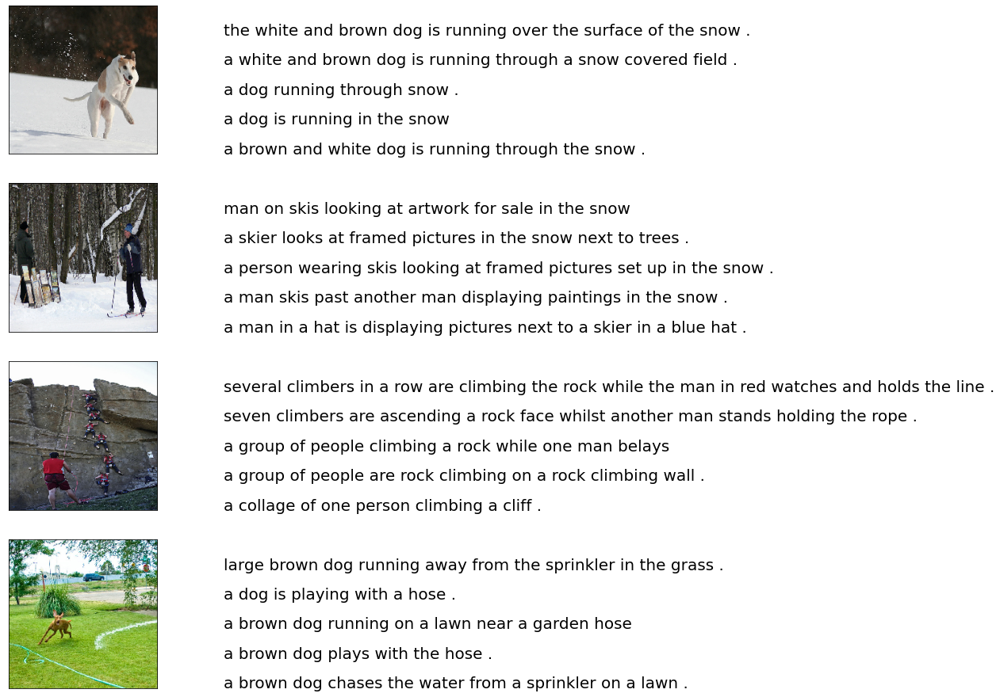

In [ ]:
npic = 5
npix = 224
target_size = (npix,npix,3)  #224,224,3
count = 1

fig = plt.figure(figsize=(10,20))
for jpgfnm in uni_filenames[10:14]:
   filename = image_path + '/' + jpgfnm
   captions = list(data["caption"].loc[data["filename"]==jpgfnm].values)
   image_load = load_img(filename, target_size=target_size)
   ax = fig.add_subplot(npic,2,count,xticks=[],yticks=[])
   ax.imshow(image_load)
   count += 1

   ax = fig.add_subplot(npic,2,count)
   plt.axis('off')
   ax.plot()
   ax.set_xlim(0,1)
   ax.set_ylim(0,len(captions))
   for i, caption in enumerate(captions):
       ax.text(0,i,caption,fontsize=20)
   count += 1
plt.show()

In [ ]:
vocabulary = []
for txt in data.caption.values:
   vocabulary.extend(txt.split())
print('Vocabulary Size: %d' % len(set(vocabulary)))

Vocabulary Size: 8918


In [ ]:
def remove_punctuation(text_original):
   text_no_punctuation = text_original.translate(string.punctuation)
   return(text_no_punctuation)

def remove_single_character(text):
   text_len_more_than1 = ""
   for word in text.split():
       if len(word) > 1:
           text_len_more_than1 += " " + word
   return(text_len_more_than1)

def remove_numeric(text):
   text_no_numeric = ""
   for word in text.split():
       isalpha = word.isalpha()
       if isalpha:
           text_no_numeric += " " + word
   return(text_no_numeric)

def text_clean(text_original):
   text = remove_punctuation(text_original)
   text = remove_single_character(text)
   text = remove_numeric(text)
   return(text)

for i, caption in enumerate(data.caption.values):
   newcaption = text_clean(caption)
   data["caption"].iloc[i] = newcaption

In [ ]:
clean_vocabulary = []
for txt in data.caption.values:
   clean_vocabulary.extend(txt.split())
print('Clean Vocabulary Size: %d' % len(set(clean_vocabulary)))

Clean Vocabulary Size: 8357


In [ ]:
PATH = "/content/Flicker8k_Dataset/"
all_captions = []
for caption  in data["caption"].astype(str):
   caption = '<start> ' + caption+ ' <end>'
   all_captions.append(caption)

all_captions[:10]

['<start>  child in pink dress is climbing up set of stairs in an entry way <end>',
 '<start>  girl going into wooden building <end>',
 '<start>  little girl climbing into wooden playhouse <end>',
 '<start>  little girl climbing the stairs to her playhouse <end>',
 '<start>  little girl in pink dress going into wooden cabin <end>',
 '<start>  black dog and spotted dog are fighting <end>',
 '<start>  black dog and dog playing with each other on the road <end>',
 '<start>  black dog and white dog with brown spots are staring at each other in the street <end>',
 '<start>  two dogs of different breeds looking at each other on the road <end>',
 '<start>  two dogs on pavement moving toward each other <end>']

In [ ]:
all_img_name_vector = []
for annot in data["filename"]:
   full_image_path = PATH + annot
   all_img_name_vector.append(full_image_path)

all_img_name_vector[:10]

['/content/Flicker8k_Dataset/1000268201_693b08cb0e.jpg',
 '/content/Flicker8k_Dataset/1000268201_693b08cb0e.jpg',
 '/content/Flicker8k_Dataset/1000268201_693b08cb0e.jpg',
 '/content/Flicker8k_Dataset/1000268201_693b08cb0e.jpg',
 '/content/Flicker8k_Dataset/1000268201_693b08cb0e.jpg',
 '/content/Flicker8k_Dataset/1001773457_577c3a7d70.jpg',
 '/content/Flicker8k_Dataset/1001773457_577c3a7d70.jpg',
 '/content/Flicker8k_Dataset/1001773457_577c3a7d70.jpg',
 '/content/Flicker8k_Dataset/1001773457_577c3a7d70.jpg',
 '/content/Flicker8k_Dataset/1001773457_577c3a7d70.jpg']

In [ ]:
#Clarify
def data_limiter(num,total_captions,all_img_name_vector):
 train_captions, img_name_vector = shuffle(total_captions,all_img_name_vector,random_state=1)
 train_captions = train_captions[:num]
 img_name_vector = img_name_vector[:num]
 return train_captions,img_name_vector

train_captions,img_name_vector = data_limiter(40000,all_captions,all_img_name_vector)

In [ ]:
def load_image(image_path):    
   img = tf.io.read_file(image_path)
   img = tf.image.decode_jpeg(img, channels=3)
   img = tf.image.resize(img, (224, 224))
   print('Shape before preprocess:', img.shape)
   #img = preprocess_input(img)
   print('Shape after preprocess:' , img.shape)

   return img, image_path #224,224,3

#image_model = tf.keras.applications.VGG16(include_top=False, weights='imagenet')

image_model = ResNet50(include_top=False,weights='imagenet',input_shape=(224, 224,3),pooling="avg")

new_input = image_model.input
hidden_layer = image_model.layers[-2].output
image_features_extract_model = tf.keras.Model(new_input, hidden_layer)

image_features_extract_model.summary()

94781440/94765736 [==============================] - 1s 0us/step
Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 230, 230, 3)  0           ['input_1[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 112, 112, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                             

In [ ]:
image_model_check = tf.keras.applications.VGG16(include_top=False, weights='imagenet')

58900480/58889256 [==============================] - 1s 0us/step


In [ ]:
encode_train = sorted(set(img_name_vector))
image_dataset = tf.data.Dataset.from_tensor_slices(encode_train)
image_dataset = image_dataset.map(load_image, num_parallel_calls=tf.data.experimental.AUTOTUNE).batch(64)

Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


In [ ]:
len(encode_train)

8091

In [ ]:
type(image_dataset)

tensorflow.python.data.ops.dataset_ops.BatchDataset

In [ ]:
for x,y in image_dataset:
    print(x.shape,y.shape)
    break

(64, 224, 224, 3) (64,)


In [ ]:
encode_train[0]

'/content/Flicker8k_Dataset/1000268201_693b08cb0e.jpg'

In [ ]:
type(encode_train),type(img_name_vector),type(image_dataset)

(list, list, tensorflow.python.data.ops.dataset_ops.BatchDataset)

In [ ]:
%%time
for img, path in tqdm(image_dataset):
 batch_features = image_features_extract_model(img)
 print(batch_features.shape) #(64, 7, 7, 512)
 batch_features = tf.reshape(batch_features,
                             (batch_features.shape[0], -1, batch_features.shape[3]))
 #print(batch_features.shape)  #(64, 49, 512)
 

 for bf, p in zip(batch_features, path):
   path_of_feature = p.numpy().decode("utf-8")
   #print(path_of_feature)
   np.save(path_of_feature, bf.numpy())
 #break

  1%|          | 1/127 [00:09<19:31,  9.30s/it]

(64, 7, 7, 2048)


  2%|▏         | 2/127 [00:09<08:28,  4.07s/it]

(64, 7, 7, 2048)


  2%|▏         | 3/127 [00:09<04:47,  2.32s/it]

(64, 7, 7, 2048)


  3%|▎         | 4/127 [00:10<03:03,  1.49s/it]

(64, 7, 7, 2048)


  4%|▍         | 5/127 [00:10<02:07,  1.05s/it]

(64, 7, 7, 2048)


  5%|▍         | 6/127 [00:10<01:35,  1.26it/s]

(64, 7, 7, 2048)


  6%|▌         | 7/127 [00:10<01:14,  1.61it/s]

(64, 7, 7, 2048)


  6%|▋         | 8/127 [00:11<01:00,  1.97it/s]

(64, 7, 7, 2048)


  7%|▋         | 9/127 [00:11<00:51,  2.29it/s]

(64, 7, 7, 2048)


  8%|▊         | 10/127 [00:11<00:44,  2.64it/s]

(64, 7, 7, 2048)


  9%|▊         | 11/127 [00:12<00:39,  2.95it/s]

(64, 7, 7, 2048)


  9%|▉         | 12/127 [00:12<00:36,  3.19it/s]

(64, 7, 7, 2048)


 10%|█         | 13/127 [00:12<00:35,  3.19it/s]

(64, 7, 7, 2048)


 11%|█         | 14/127 [00:12<00:33,  3.37it/s]

(64, 7, 7, 2048)


 12%|█▏        | 15/127 [00:13<00:31,  3.59it/s]

(64, 7, 7, 2048)


 13%|█▎        | 16/127 [00:13<00:29,  3.77it/s]

(64, 7, 7, 2048)


 13%|█▎        | 17/127 [00:13<00:27,  3.93it/s]

(64, 7, 7, 2048)


 14%|█▍        | 18/127 [00:13<00:28,  3.84it/s]

(64, 7, 7, 2048)


 15%|█▍        | 19/127 [00:14<00:29,  3.61it/s]

(64, 7, 7, 2048)


 16%|█▌        | 20/127 [00:14<00:28,  3.75it/s]

(64, 7, 7, 2048)


 17%|█▋        | 21/127 [00:14<00:28,  3.73it/s]

(64, 7, 7, 2048)


 17%|█▋        | 22/127 [00:14<00:27,  3.85it/s]

(64, 7, 7, 2048)


 18%|█▊        | 23/127 [00:15<00:26,  3.91it/s]

(64, 7, 7, 2048)


 19%|█▉        | 24/127 [00:15<00:28,  3.65it/s]

(64, 7, 7, 2048)


 20%|█▉        | 25/127 [00:15<00:27,  3.68it/s]

(64, 7, 7, 2048)


 20%|██        | 26/127 [00:15<00:26,  3.84it/s]

(64, 7, 7, 2048)


 21%|██▏       | 27/127 [00:16<00:25,  3.95it/s]

(64, 7, 7, 2048)


 22%|██▏       | 28/127 [00:16<00:24,  3.99it/s]

(64, 7, 7, 2048)


 23%|██▎       | 29/127 [00:16<00:26,  3.70it/s]

(64, 7, 7, 2048)


 24%|██▎       | 30/127 [00:17<00:25,  3.80it/s]

(64, 7, 7, 2048)


 24%|██▍       | 31/127 [00:17<00:25,  3.79it/s]

(64, 7, 7, 2048)


 25%|██▌       | 32/127 [00:17<00:25,  3.73it/s]

(64, 7, 7, 2048)


 26%|██▌       | 33/127 [00:17<00:25,  3.75it/s]

(64, 7, 7, 2048)


 27%|██▋       | 34/127 [00:18<00:24,  3.76it/s]

(64, 7, 7, 2048)
(64, 7, 7, 2048)


 28%|██▊       | 36/127 [00:18<00:23,  3.90it/s]

(64, 7, 7, 2048)


 29%|██▉       | 37/127 [00:18<00:22,  3.94it/s]

(64, 7, 7, 2048)


 30%|██▉       | 38/127 [00:19<00:24,  3.64it/s]

(64, 7, 7, 2048)


 31%|███       | 39/127 [00:19<00:24,  3.66it/s]

(64, 7, 7, 2048)


 31%|███▏      | 40/127 [00:19<00:23,  3.67it/s]

(64, 7, 7, 2048)


 32%|███▏      | 41/127 [00:19<00:22,  3.80it/s]

(64, 7, 7, 2048)
(64, 7, 7, 2048)


 34%|███▍      | 43/127 [00:20<00:23,  3.65it/s]

(64, 7, 7, 2048)


 35%|███▍      | 44/127 [00:20<00:22,  3.73it/s]

(64, 7, 7, 2048)


 35%|███▌      | 45/127 [00:20<00:21,  3.84it/s]

(64, 7, 7, 2048)


 36%|███▌      | 46/127 [00:21<00:21,  3.71it/s]

(64, 7, 7, 2048)


 37%|███▋      | 47/127 [00:21<00:21,  3.80it/s]

(64, 7, 7, 2048)


 38%|███▊      | 48/127 [00:21<00:20,  3.78it/s]

(64, 7, 7, 2048)


 39%|███▊      | 49/127 [00:22<00:20,  3.82it/s]

(64, 7, 7, 2048)


 39%|███▉      | 50/127 [00:22<00:19,  3.92it/s]

(64, 7, 7, 2048)
(64, 7, 7, 2048)


 41%|████      | 52/127 [00:22<00:20,  3.62it/s]

(64, 7, 7, 2048)


 42%|████▏     | 53/127 [00:23<00:20,  3.68it/s]

(64, 7, 7, 2048)


 43%|████▎     | 54/127 [00:23<00:19,  3.72it/s]

(64, 7, 7, 2048)


 43%|████▎     | 55/127 [00:23<00:18,  3.80it/s]

(64, 7, 7, 2048)


 44%|████▍     | 56/127 [00:23<00:17,  3.96it/s]

(64, 7, 7, 2048)
(64, 7, 7, 2048)


 46%|████▌     | 58/127 [00:24<00:17,  3.84it/s]

(64, 7, 7, 2048)


 46%|████▋     | 59/127 [00:24<00:17,  3.82it/s]

(64, 7, 7, 2048)


 47%|████▋     | 60/127 [00:24<00:17,  3.88it/s]

(64, 7, 7, 2048)
(64, 7, 7, 2048)


 49%|████▉     | 62/127 [00:25<00:17,  3.70it/s]

(64, 7, 7, 2048)


 50%|████▉     | 63/127 [00:25<00:17,  3.76it/s]

(64, 7, 7, 2048)


 50%|█████     | 64/127 [00:26<00:16,  3.80it/s]

(64, 7, 7, 2048)


 51%|█████     | 65/127 [00:26<00:15,  3.92it/s]

(64, 7, 7, 2048)
(64, 7, 7, 2048)


 53%|█████▎    | 67/127 [00:26<00:16,  3.66it/s]

(64, 7, 7, 2048)
(64, 7, 7, 2048)


 54%|█████▍    | 69/127 [00:27<00:14,  3.89it/s]

(64, 7, 7, 2048)


 55%|█████▌    | 70/127 [00:27<00:14,  3.90it/s]

(64, 7, 7, 2048)


 56%|█████▌    | 71/127 [00:27<00:14,  3.77it/s]

(64, 7, 7, 2048)


 57%|█████▋    | 72/127 [00:28<00:14,  3.83it/s]

(64, 7, 7, 2048)
(64, 7, 7, 2048)


 58%|█████▊    | 74/127 [00:28<00:13,  3.82it/s]

(64, 7, 7, 2048)


 59%|█████▉    | 75/127 [00:28<00:13,  3.95it/s]

(64, 7, 7, 2048)


 60%|█████▉    | 76/127 [00:29<00:13,  3.91it/s]

(64, 7, 7, 2048)


 61%|██████    | 77/127 [00:29<00:12,  3.95it/s]

(64, 7, 7, 2048)


 61%|██████▏   | 78/127 [00:29<00:12,  3.95it/s]

(64, 7, 7, 2048)


 62%|██████▏   | 79/127 [00:29<00:12,  3.72it/s]

(64, 7, 7, 2048)


 63%|██████▎   | 80/127 [00:30<00:12,  3.76it/s]

(64, 7, 7, 2048)


 64%|██████▍   | 81/127 [00:30<00:12,  3.82it/s]

(64, 7, 7, 2048)
(64, 7, 7, 2048)


 65%|██████▌   | 83/127 [00:31<00:11,  3.67it/s]

(64, 7, 7, 2048)


 66%|██████▌   | 84/127 [00:31<00:11,  3.90it/s]

(64, 7, 7, 2048)


 67%|██████▋   | 85/127 [00:31<00:10,  3.82it/s]

(64, 7, 7, 2048)


 68%|██████▊   | 86/127 [00:31<00:10,  3.94it/s]

(64, 7, 7, 2048)


 69%|██████▊   | 87/127 [00:31<00:10,  3.91it/s]

(64, 7, 7, 2048)


 69%|██████▉   | 88/127 [00:32<00:10,  3.64it/s]

(64, 7, 7, 2048)


 70%|███████   | 89/127 [00:32<00:10,  3.74it/s]

(64, 7, 7, 2048)


 71%|███████   | 90/127 [00:32<00:09,  3.85it/s]

(64, 7, 7, 2048)


 72%|███████▏  | 91/127 [00:33<00:09,  3.73it/s]

(64, 7, 7, 2048)


 72%|███████▏  | 92/127 [00:33<00:09,  3.71it/s]

(64, 7, 7, 2048)


 73%|███████▎  | 93/127 [00:33<00:09,  3.70it/s]

(64, 7, 7, 2048)


 74%|███████▍  | 94/127 [00:33<00:08,  3.75it/s]

(64, 7, 7, 2048)


 75%|███████▍  | 95/127 [00:34<00:08,  3.62it/s]

(64, 7, 7, 2048)


 76%|███████▌  | 96/127 [00:34<00:07,  4.03it/s]

(64, 7, 7, 2048)


 76%|███████▋  | 97/127 [00:34<00:08,  3.63it/s]

(64, 7, 7, 2048)


 77%|███████▋  | 98/127 [00:34<00:08,  3.62it/s]

(64, 7, 7, 2048)
(64, 7, 7, 2048)


 79%|███████▊  | 100/127 [00:35<00:07,  3.70it/s]

(64, 7, 7, 2048)


 80%|███████▉  | 101/127 [00:35<00:07,  3.71it/s]

(64, 7, 7, 2048)


 80%|████████  | 102/127 [00:36<00:06,  3.68it/s]

(64, 7, 7, 2048)
(64, 7, 7, 2048)


 82%|████████▏ | 104/127 [00:36<00:07,  3.25it/s]

(64, 7, 7, 2048)


 83%|████████▎ | 105/127 [00:37<00:06,  3.49it/s]

(64, 7, 7, 2048)


 83%|████████▎ | 106/127 [00:37<00:05,  3.56it/s]

(64, 7, 7, 2048)


 84%|████████▍ | 107/127 [00:37<00:05,  3.56it/s]

(64, 7, 7, 2048)
(64, 7, 7, 2048)


 86%|████████▌ | 109/127 [00:38<00:04,  3.62it/s]

(64, 7, 7, 2048)


 87%|████████▋ | 110/127 [00:38<00:04,  3.88it/s]

(64, 7, 7, 2048)
(64, 7, 7, 2048)


 88%|████████▊ | 112/127 [00:38<00:04,  3.65it/s]

(64, 7, 7, 2048)


 89%|████████▉ | 113/127 [00:39<00:03,  3.89it/s]

(64, 7, 7, 2048)
(64, 7, 7, 2048)


 91%|█████████ | 115/127 [00:39<00:03,  3.56it/s]

(64, 7, 7, 2048)


 91%|█████████▏| 116/127 [00:39<00:03,  3.66it/s]

(64, 7, 7, 2048)


 92%|█████████▏| 117/127 [00:40<00:02,  3.42it/s]

(64, 7, 7, 2048)


 93%|█████████▎| 118/127 [00:40<00:02,  3.44it/s]

(64, 7, 7, 2048)


 94%|█████████▎| 119/127 [00:40<00:02,  3.74it/s]

(64, 7, 7, 2048)
(64, 7, 7, 2048)


 95%|█████████▌| 121/127 [00:41<00:01,  3.26it/s]

(64, 7, 7, 2048)


 96%|█████████▌| 122/127 [00:41<00:01,  3.36it/s]

(64, 7, 7, 2048)


 97%|█████████▋| 123/127 [00:42<00:01,  3.59it/s]

(64, 7, 7, 2048)
(64, 7, 7, 2048)


 98%|█████████▊| 125/127 [00:42<00:00,  3.72it/s]

(64, 7, 7, 2048)
(64, 7, 7, 2048)


100%|██████████| 127/127 [00:42<00:00,  4.36it/s]

(27, 7, 7, 2048)


100%|██████████| 127/127 [01:21<00:00,  1.55it/s]

CPU times: user 50 s, sys: 6.1 s, total: 56.1 s
Wall time: 1min 21s


In [ ]:
top_k = 5000
tokenizer = tf.keras.preprocessing.text.Tokenizer(num_words=top_k,
                                                 oov_token="<unk>",
                                                 filters='!"#$%&()*+.,-/:;=?@[\]^_`{|}~ ')

tokenizer.fit_on_texts(train_captions)
train_seqs = tokenizer.texts_to_sequences(train_captions)
tokenizer.word_index['<pad>'] = 0
tokenizer.index_word[0] = '<pad>'

train_seqs = tokenizer.texts_to_sequences(train_captions)
cap_vector = tf.keras.preprocessing.sequence.pad_sequences(train_seqs, padding='post')

In [ ]:
len(cap_vector[0])

33

In [ ]:
def calc_max_length(tensor):
   return max(len(t) for t in tensor)
max_length = calc_max_length(train_seqs)

def calc_min_length(tensor):
   return min(len(t) for t in tensor)
min_length = calc_min_length(train_seqs)

print('Max Length of any caption : Min Length of any caption = '+ str(max_length) +" : "+str(min_length))

Max Length of any caption : Min Length of any caption = 33 : 2


In [ ]:
img_name_train, img_name_val, cap_train, cap_val = train_test_split(img_name_vector,cap_vector, test_size=0.2, random_state=0)

In [ ]:
BATCH_SIZE = 64
BUFFER_SIZE = 1000
embedding_dim = 256
units = 512
vocab_size = len(tokenizer.word_index) + 1
num_steps = len(img_name_train) // BATCH_SIZE
features_shape = 512
attention_features_shape = 49

In [ ]:
#Clarify
def map_func(img_name, cap):
 img_tensor = np.load(img_name.decode('utf-8')+'.npy')
#  print(img_name.decode('utf-8')+'.npy')
#  print(type(img_tensor))
 return img_tensor, cap
dataset = tf.data.Dataset.from_tensor_slices((img_name_train, cap_train))

# Use map to load the numpy files in parallel
dataset = dataset.map(lambda item1, item2: tf.numpy_function(
        map_func, [item1, item2], [tf.float32, tf.int32]),
         num_parallel_calls=tf.data.experimental.AUTOTUNE)

dataset = dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
dataset = dataset.prefetch(buffer_size=tf.data.experimental.AUTOTUNE)

In [ ]:
img_tensor = np.load('/content/Flicker8k_Dataset/3648988742_888a16f600.jpg.npy')
print(type(img_tensor))

<class 'numpy.ndarray'>


In [ ]:
for x,y in dataset:
    print(x)
    break

tf.Tensor(
[[[0.3644042  0.         0.         ... 8.232544   0.         0.        ]
  [1.2729619  0.         0.         ... 3.9129677  0.         0.        ]
  [0.         0.         0.         ... 2.3112442  0.         0.        ]
  ...
  [0.         0.         0.         ... 0.         0.5758977  0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  [0.         0.         0.         ... 0.         0.         0.        ]
  ...
  [2.8033671  1.8746221  0.         ... 0.         1.4167559  2.9748268 ]
  [3.2651763  5.3502293  0.         ... 0.         6.0918837  0.        ]
  [0.         6.8373976  0.         ... 0.         0.         0.        ]]

 [[0.         0.         0.         ... 0.         0.         0.        ]
  [0.      

In [ ]:
class Resnet50_Encoder(tf.keras.Model):
   # This encoder passes the features through a Fully connected layer
   def __init__(self, embedding_dim):
       super(Resnet50_Encoder, self).__init__()
       # shape after fc == (batch_size, 49, embedding_dim)
       self.fc = tf.keras.layers.Dense(embedding_dim)
       self.dropout = tf.keras.layers.Dropout(0.5, noise_shape=None, seed=None)

   def call(self, x):
       #x= self.dropout(x)
       x = self.fc(x)
       x = tf.nn.relu(x)
       return x   
#We define our RNN based on GPU/CPU capabilities-

def rnn_type(units):
   if tf.test.is_gpu_available():
       return tf.compat.v1.keras.layers.CuDNNLSTM(units,
                                       return_sequences=True,
                                       return_state=True,
                                       recurrent_initializer='glorot_uniform')
   else:
       return tf.keras.layers.GRU(units,
                                  return_sequences=True,
                                  return_state=True,
                                  recurrent_activation='sigmoid',
                                  recurrent_initializer='glorot_uniform')

In [ ]:
encoder = Resnet50_Encoder(embedding_dim)

In [ ]:
#For later
#from torchsummary import summary
#summary(encoder, input_size=(1, 49, 3))

In [ ]:
'''The encoder output(i.e. 'features'), hidden state(initialized to 0)(i.e. 'hidden') and
the decoder input (which is the start token)(i.e. 'x') is passed to the decoder.'''

class Rnn_Local_Decoder(tf.keras.Model):
 def __init__(self, embedding_dim, units, vocab_size):
   super(Rnn_Local_Decoder, self).__init__()
   self.units = units
   self.embedding = tf.keras.layers.Embedding(vocab_size, embedding_dim)
   self.gru = tf.keras.layers.GRU(self.units,
                                  return_sequences=True,
                                  return_state=True,
                                  recurrent_initializer='glorot_uniform')
  
   self.fc1 = tf.keras.layers.Dense(self.units)

   self.dropout = tf.keras.layers.Dropout(0.5, noise_shape=None, seed=None)
   self.batchnormalization = tf.keras.layers.BatchNormalization(axis=-1, momentum=0.99, epsilon=0.001, center=True, scale=True, beta_initializer='zeros', gamma_initializer='ones', moving_mean_initializer='zeros', moving_variance_initializer='ones', beta_regularizer=None, gamma_regularizer=None, beta_constraint=None, gamma_constraint=None)

   self.fc2 = tf.keras.layers.Dense(vocab_size)

   # Implementing Attention Mechanism
   self.Uattn = tf.keras.layers.Dense(units)
   self.Wattn = tf.keras.layers.Dense(units)
   self.Vattn = tf.keras.layers.Dense(1)

 def call(self, x, features, hidden):
   # features shape ==> (64,49,256) ==> Output from ENCODER
   # hidden shape == (batch_size, hidden_size) ==>(64,512)
   # hidden_with_time_axis shape == (batch_size, 1, hidden_size) ==> (64,1,512)

   hidden_with_time_axis = tf.expand_dims(hidden, 1)

   # score shape == (64, 49, 1)
   # Attention Function
   '''e(ij) = f(s(t-1),h(j))'''
   ''' e(ij) = Vattn(T)*tanh(Uattn * h(j) + Wattn * s(t))'''

   score = self.Vattn(tf.nn.tanh(self.Uattn(features) + self.Wattn(hidden_with_time_axis)))

   # self.Uattn(features) : (64,49,512)
   # self.Wattn(hidden_with_time_axis) : (64,1,512)
   # tf.nn.tanh(self.Uattn(features) + self.Wattn(hidden_with_time_axis)) : (64,49,512)
   # self.Vattn(tf.nn.tanh(self.Uattn(features) + self.Wattn(hidden_with_time_axis))) : (64,49,1) ==> score

   # you get 1 at the last axis because you are applying score to self.Vattn
   # Then find Probability using Softmax
   '''attention_weights(alpha(ij)) = softmax(e(ij))'''

   attention_weights = tf.nn.softmax(score, axis=1)

   # attention_weights shape == (64, 49, 1)
   # Give weights to the different pixels in the image
   ''' C(t) = Summation(j=1 to T) (attention_weights * VGG-16 features) '''

   context_vector = attention_weights * features
   context_vector = tf.reduce_sum(context_vector, axis=1)

   # Context Vector(64,256) = AttentionWeights(64,49,1) * features(64,49,256)
   # context_vector shape after sum == (64, 256)
   # x shape after passing through embedding == (64, 1, 256)

   x = self.embedding(x)
   # x shape after concatenation == (64, 1,  512)

   x = tf.concat([tf.expand_dims(context_vector, 1), x], axis=-1)
   # passing the concatenated vector to the GRU

   output, state = self.gru(x)
   # shape == (batch_size, max_length, hidden_size)

   x = self.fc1(output)
   # x shape == (batch_size * max_length, hidden_size)

   x = tf.reshape(x, (-1, x.shape[2]))

   # Adding Dropout and BatchNorm Layers
   x= self.dropout(x)
   x= self.batchnormalization(x)

   # output shape == (64 * 512)
   x = self.fc2(x)

   # shape : (64 * 8329(vocab))
   return x, state, attention_weights

 def reset_state(self, batch_size):
   return tf.zeros((batch_size, self.units))


encoder = Resnet50_Encoder(embedding_dim)
decoder = Rnn_Local_Decoder(embedding_dim, units, vocab_size)

In [ ]:
optimizer = tf.keras.optimizers.Adam()
loss_object = tf.keras.losses.SparseCategoricalCrossentropy(
   from_logits=True, reduction='none')

def loss_function(real, pred):
 mask = tf.math.logical_not(tf.math.equal(real, 0))
 loss_ = loss_object(real, pred)
 mask = tf.cast(mask, dtype=loss_.dtype)
 loss_ *= mask
 return tf.reduce_mean(loss_)

In [ ]:
[tokenizer.word_index['<start>']] * BATCH_SIZE

[2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2]

In [ ]:
 dec_input1 = tf.expand_dims([tokenizer.word_index['<start>']] * BATCH_SIZE, 1)

In [ ]:
dec_input1

<tf.Tensor: shape=(64, 1), dtype=int32, numpy=
array([[2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2],
       [2]], dtype=int32)>

In [ ]:
dec_input1.shape

TensorShape([64, 1])

In [ ]:
loss_plot = []

@tf.function
def train_step(img_tensor, target):
 loss = 0
 # initializing the hidden state for each batch
 # because the captions are not related from image to image

 hidden = decoder.reset_state(batch_size=target.shape[0])
 dec_input = tf.expand_dims([tokenizer.word_index['<start>']] * BATCH_SIZE, 1)

 with tf.GradientTape() as tape:
     features = encoder(img_tensor)
     for i in range(1, target.shape[1]):
         # passing the features through the decoder
         predictions, hidden, _ = decoder(dec_input, features, hidden)
         loss += loss_function(target[:, i], predictions)

         # using teacher forcing
         dec_input = tf.expand_dims(target[:, i], 1)

 total_loss = (loss / int(target.shape[1]))
 trainable_variables = encoder.trainable_variables + decoder.trainable_variables
 gradients = tape.gradient(loss, trainable_variables)
 optimizer.apply_gradients(zip(gradients, trainable_variables))

 return loss, total_loss

In [ ]:
start_epoch=0

In [ ]:
EPOCHS = 50
for epoch in range(start_epoch, EPOCHS):
   start = time.time()
   total_loss = 0

   for (batch, (img_tensor, target)) in enumerate(dataset):
       batch_loss, t_loss = train_step(img_tensor, target)
       total_loss += t_loss

       if batch % 100 == 0:
           print ('Epoch {} Batch {} Loss {:.4f}'.format(
             epoch + 1, batch, batch_loss.numpy() / int(target.shape[1])))
   # storing the epoch end loss value to plot later
   loss_plot.append(total_loss / num_steps)

   print ('Epoch {} Loss {:.6f}'.format(epoch + 1,
                                        total_loss/num_steps))

   print ('Time taken for 1 epoch {} sec\n'.format(time.time() - start))


Epoch 1 Batch 0 Loss 2.5233
Epoch 1 Batch 100 Loss 1.7463
Epoch 1 Batch 200 Loss 1.5435
Epoch 1 Batch 300 Loss 1.4581
Epoch 1 Batch 400 Loss 1.1403
Epoch 1 Loss 1.476989
Time taken for 1 epoch 101.18134641647339 sec

Epoch 2 Batch 0 Loss 1.1644
Epoch 2 Batch 100 Loss 1.2866
Epoch 2 Batch 200 Loss 1.1244
Epoch 2 Batch 300 Loss 1.1496
Epoch 2 Batch 400 Loss 1.0722
Epoch 2 Loss 1.121875
Time taken for 1 epoch 60.55413246154785 sec

Epoch 3 Batch 0 Loss 1.0386
Epoch 3 Batch 100 Loss 0.9586
Epoch 3 Batch 200 Loss 1.0516
Epoch 3 Batch 300 Loss 0.9298
Epoch 3 Batch 400 Loss 0.9196
Epoch 3 Loss 1.006971
Time taken for 1 epoch 60.21755337715149 sec

Epoch 4 Batch 0 Loss 0.9060
Epoch 4 Batch 100 Loss 0.9503
Epoch 4 Batch 200 Loss 0.9438
Epoch 4 Batch 300 Loss 0.9674
Epoch 4 Batch 400 Loss 0.9286
Epoch 4 Loss 0.924490
Time taken for 1 epoch 60.02174162864685 sec

Epoch 5 Batch 0 Loss 0.9186
Epoch 5 Batch 100 Loss 0.8911
Epoch 5 Batch 200 Loss 0.8169
Epoch 5 Batch 300 Loss 0.8550
Epoch 5 Batch 400

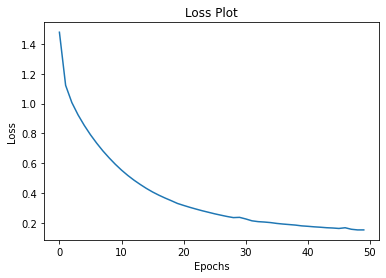

In [ ]:
#Let’s plot the error graph:

plt.plot(loss_plot)
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Loss Plot')
plt.show()

In [ ]:
def evaluate(image):
   attention_plot = np.zeros((max_length, attention_features_shape))

   hidden = decoder.reset_state(batch_size=1)
   temp_input = tf.expand_dims(load_image(image)[0], 0)
   img_tensor_val = image_features_extract_model(temp_input)
   img_tensor_val = tf.reshape(img_tensor_val, (img_tensor_val.shape[0], -1, img_tensor_val.shape[3]))
   features = encoder(img_tensor_val)
   dec_input = tf.expand_dims([tokenizer.word_index['<start>']], 0)
   result = []

   for i in range(max_length):
       predictions, hidden, attention_weights = decoder(dec_input, features, hidden)
       attention_plot[i] = tf.reshape(attention_weights, (-1, )).numpy()
       predicted_id = tf.argmax(predictions[0]).numpy()
       result.append(tokenizer.index_word[predicted_id])

       if tokenizer.index_word[predicted_id] == '<end>':
           return result, attention_plot

       dec_input = tf.expand_dims([predicted_id], 0)
   attention_plot = attention_plot[:len(result), :]

   return result, attention_plot

In [ ]:
def plot_attention(image, result, attention_plot):
   temp_image = np.array(Image.open(image))
   fig = plt.figure(figsize=(10, 10))
   len_result = len(result)
   for l in range(len_result):
       temp_att = np.resize(attention_plot[l], (8, 8))
       ax = fig.add_subplot(len_result//2, len_result//2, l+1)
       ax.set_title(result[l])
       img = ax.imshow(temp_image)
       ax.imshow(temp_att, cmap='gray', alpha=0.6, extent=img.get_extent())

   plt.tight_layout()
   plt.show()

Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)
BELU score: 72.59795291154771
Real Caption: Two white dogs are playing in the snow
Prediction Caption: two white dogs are playing in the snow


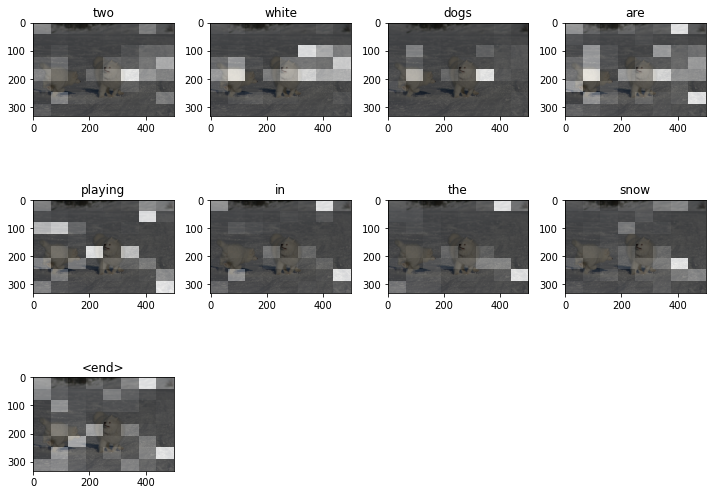

In [ ]:
# captions on the validation set
rid = np.random.randint(0, len(img_name_val))
image = '/content/Flicker8k_Dataset/2319175397_3e586cfaf8.jpg'

# real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
result, attention_plot = evaluate(image)

# remove <start> and <end> from the real_caption
real_caption = 'Two white dogs are playing in the snow'
first = real_caption.split(' ', 1)[1]
real_caption = 'Two white dogs are playing in the snow'

#remove "<unk>" in result
for i in result:
   if i=="<unk>":
       result.remove(i)

for i in real_caption:
   if i=="<unk>":
       real_caption.remove(i)

#remove <end> from result        
result_join = ' '.join(result)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = result

score = sentence_bleu(reference, candidate)
print(f"BELU score: {score*100}")

print ('Real Caption:', real_caption)
print ('Prediction Caption:', result_final)
plot_attention(image, result, attention_plot)

Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)
Real Caption: seven jockeys riding horses in race
Prediction Caption: jockeys are performing an audience


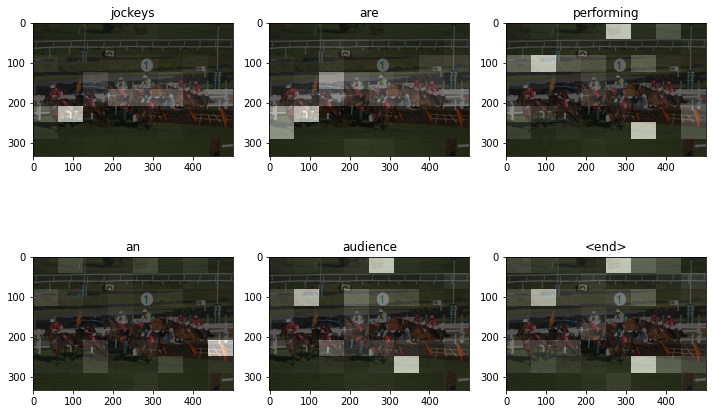

time took to Predict: 1 sec


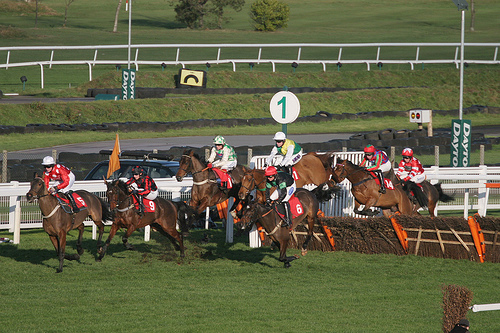

In [ ]:
rid = np.random.randint(0, len(img_name_val))
image = img_name_val[rid]
start = time.time()
real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
result, attention_plot = evaluate(image)

first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in result:
   if i=="<unk>":
       result.remove(i)

#remove <end> from result        
result_join = ' '.join(result)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = result_final

print ('Real Caption:', real_caption)
print ('Prediction Caption:', result_final)

plot_attention(image, result, attention_plot)
print(f"time took to Predict: {round(time.time()-start)} sec")

Image.open(img_name_val[rid])

Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)
BELU score: 6.223629500679345e-153
Real Caption: man in white jersey is slam dunking basketball
Prediction Caption: black man is dunking basketball while another man him on him


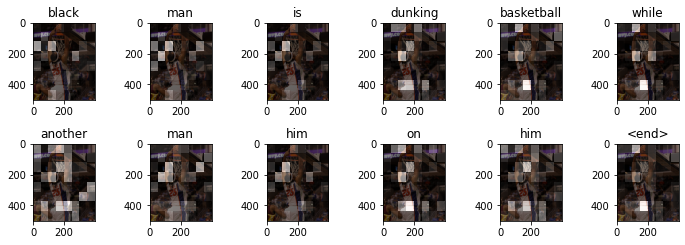

In [ ]:
rid = np.random.randint(0, len(img_name_val))
image = img_name_val[rid]

real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
result, attention_plot = evaluate(image)

# remove <start> and <end> from the real_caption
first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in result:
   if i=="<unk>":
       result.remove(i)

for i in real_caption:
   if i=="<unk>":
       real_caption.remove(i)

#remove <end> from result        
result_join = ' '.join(result)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = result

score = sentence_bleu(reference, candidate)
print(f"BELU score: {score*100}")

print ('Real Caption:', real_caption)
print ('Prediction Caption:', result_final)

plot_attention(image, result, attention_plot)

Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


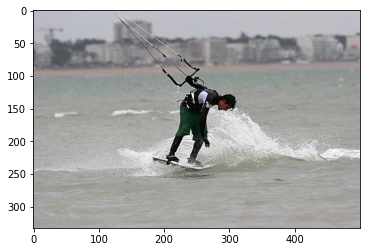

Real Caption: the man is parasailing and doing trick
Prediction Caption: man is wakeboarding from the beach
BLEU-1 score: 42.857142857142854
BLEU-2 score: 26.726124191242434
BLEU-3 score: 2.2927933779232266e-91
BLEU-4 score: 7.711523862191632e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


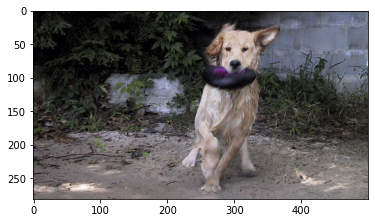

Real Caption: the wet dog catches toy while playing on the sand
Prediction Caption: light colored dog with his something
BLEU-1 score: 9.306272250443651
BLEU-2 score: 3.672797542504966e-153
BLEU-3 score: 9.305742700321069e-184
BLEU-4 score: 7.296382734947758e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


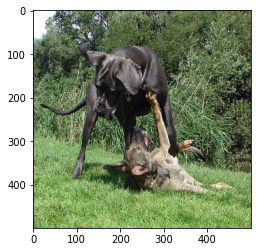

Real Caption: two dogs are wrestling in grassy field
Prediction Caption: large playfully pins the tail of brown dog tag and gray dog climbs on top of the large grassy area
BLEU-1 score: 4.761904761904762
BLEU-2 score: 3.2550867580473434e-153
BLEU-3 score: 1.0274030967649264e-183
BLEU-4 score: 8.510469113101059e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


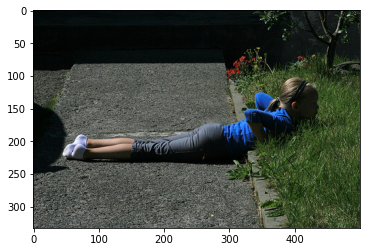

Real Caption: girl lays on the sidewalk with her arms and face in the grass
Prediction Caption: girl laying on the road
BLEU-1 score: 15.570161195729886
BLEU-2 score: 9.847434582895442
BLEU-3 score: 7.898169211184705e-92
BLEU-4 score: 2.612133206556599e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


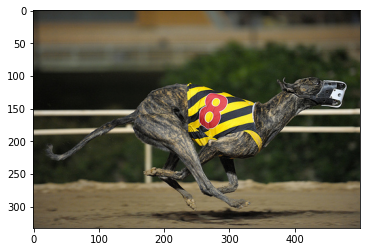

Real Caption: <unk> has the number
Prediction Caption: greyhound wearing black and white and white and white and white and white and white and white and white and white and white helmet wearing yellow jacket is blue and yellow jacket
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


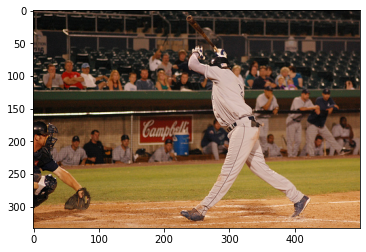

Real Caption: baseball player in white uniform is walking to base while crowd of people watch from the bleachers
Prediction Caption: baseball player is throwing the ball
BLEU-1 score: 13.694344939530048
BLEU-2 score: 7.395791548970676
BLEU-3 score: 5.9899866058552974e-92
BLEU-4 score: 1.9858854894685022e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


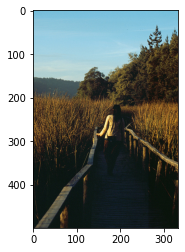

Real Caption: woman walking over bridge with tall grass on either side of her
Prediction Caption: woman walks through grassy field of golden plants
BLEU-1 score: 15.922918012750872
BLEU-2 score: 5.038498475779542e-153
BLEU-3 score: 1.168632815958936e-183
BLEU-4 score: 8.962731118674859e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


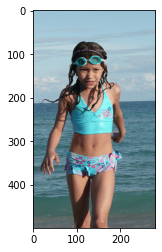

Real Caption: young girl is wearing bathing suit and the ocean is behind her
Prediction Caption: girl in blue two piece bathing suit at the beach
BLEU-1 score: 33.20366241026409
BLEU-2 score: 17.41214746376982
BLEU-3 score: 1.709709027118894e-91
BLEU-4 score: 5.94781875096292e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


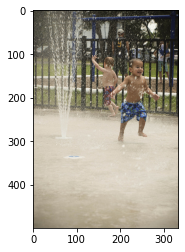

Real Caption: young boy running through water fountain
Prediction Caption: two boys are playing in sprinkler
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


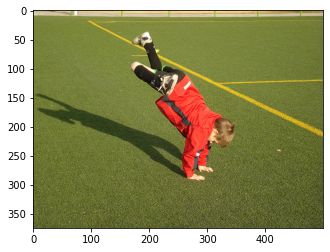

Real Caption: child in red jacket doing handstand on green grass
Prediction Caption: blond boy wearing red jacket kicks the ground
BLEU-1 score: 22.22222222222222
BLEU-2 score: 16.666666666666668
BLEU-3 score: 1.7270804940051994e-91
BLEU-4 score: 6.08970970641905e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


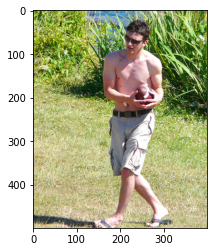

Real Caption: man with no shirt and wearing sunglasses is holding football
Prediction Caption: shirtless man is watching football
BLEU-1 score: 25.6708559516296
BLEU-2 score: 5.415362874261817e-153
BLEU-3 score: 1.0679920147725885e-183
BLEU-4 score: 7.865406450922293e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


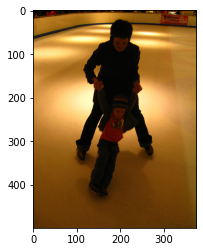

Real Caption: mom is helping her son to rollerblade
Prediction Caption: young boy pulls wearing red shirt on an ice skating with small child with red arms ice skating in the background
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


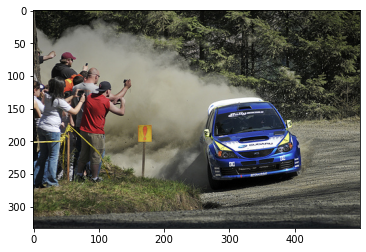

Real Caption: group of fans cheer the blue mountain racing car as it rounds the corner
Prediction Caption: spectators are taking pictures of blue rally car that is driving around bend in the dirt track with spectators
BLEU-1 score: 20.0
BLEU-2 score: 6.6709427497276e-153
BLEU-3 score: 1.5802130991274055e-183
BLEU-4 score: 1.2183324802375697e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


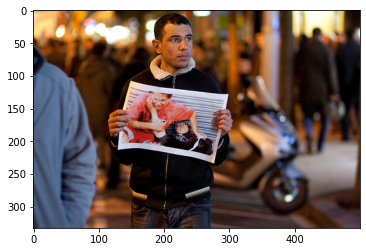

Real Caption: man is walking down the street holding up picture
Prediction Caption: man is holding up picture
BLEU-1 score: 50.54422164271946
BLEU-2 score: 42.88819424803535
BLEU-3 score: 32.503173264731565
BLEU-4 score: 4.404700362980128e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


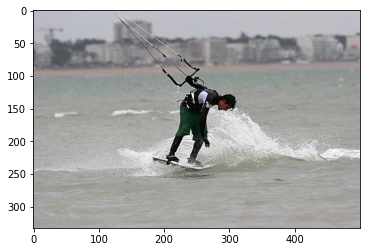

Real Caption: the man is parasailing and doing trick
Prediction Caption: man is wakeboarding from the beach
BLEU-1 score: 42.857142857142854
BLEU-2 score: 26.726124191242434
BLEU-3 score: 2.2927933779232266e-91
BLEU-4 score: 7.711523862191632e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


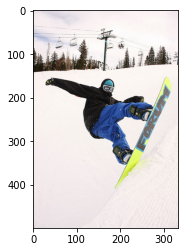

Real Caption: man wearing goggles snowboards on half pipe
Prediction Caption: the snowboarder is wearing dark top blue pants is performing trick
BLEU-1 score: 8.333333333333332
BLEU-2 score: 4.306075028866568e-153
BLEU-3 score: 1.2152126591739945e-183
BLEU-4 score: 9.788429383461836e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


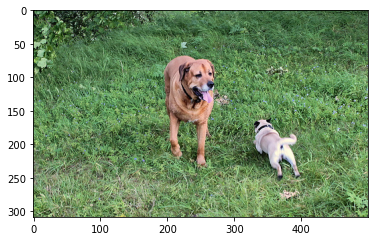

Real Caption: the large brown dog faces the little white dog on the grass
Prediction Caption: the large brown dog is running past large brown dog and runs through the grass
BLEU-1 score: 43.75
BLEU-2 score: 34.156502553198656
BLEU-3 score: 29.278891135523562
BLEU-4 score: 18.92240568795935
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


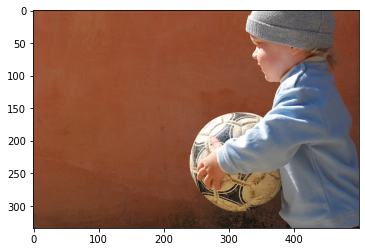

Real Caption: little boy is holding soccer ball
Prediction Caption: toddler dressed in blue shirt and cap plays with soccer ball
BLEU-1 score: 16.666666666666668
BLEU-2 score: 12.309149097933275
BLEU-3 score: 1.4399259176082162e-91
BLEU-4 score: 5.233427736988301e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


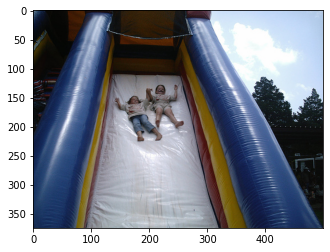

Real Caption: two girls slide down the slide
Prediction Caption: two children holding hands going down large inflatable slide
BLEU-1 score: 30.0
BLEU-2 score: 8.170202920075766e-153
BLEU-3 score: 1.7846088208682726e-183
BLEU-4 score: 1.3483065280626045e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


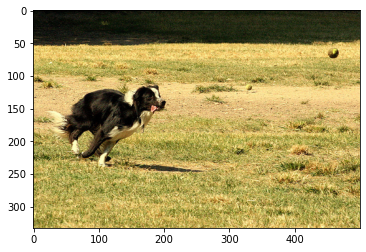

Real Caption: black and white dog runs on dry yellow field of grass
Prediction Caption: black and white dog is falling of an orange ball
BLEU-1 score: 45.45454545454545
BLEU-2 score: 36.92744729379982
BLEU-3 score: 35.03045820726322
BLEU-4 score: 24.808415001701817
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


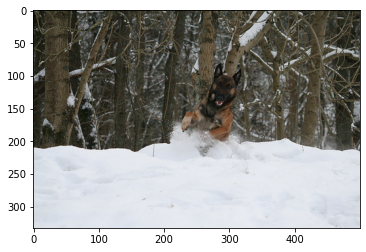

Real Caption: large german shepherd runs though deep snow
Prediction Caption: dog jumps and runs through the forest and ground
BLEU-1 score: 10.000000000000002
BLEU-2 score: 4.717068855239749e-153
BLEU-3 score: 1.2835318765197404e-183
BLEU-4 score: 1.0244914152188952e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


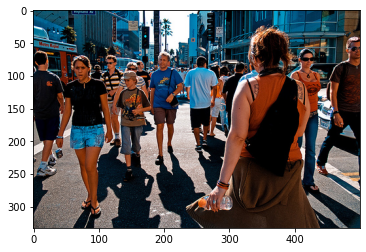

Real Caption: people in summer clothes are walking on the sidewalk of large city
Prediction Caption: group of people walking an office
BLEU-1 score: 20.980356838155135
BLEU-2 score: 4.780501720609066e-153
BLEU-3 score: 9.723067014109315e-184
BLEU-4 score: 7.2161206040200775e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


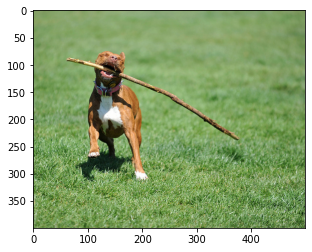

Real Caption: brown dog running with long stick in his mouth
Prediction Caption: the brown dog carried the stick in the grass
BLEU-1 score: 40.0
BLEU-2 score: 29.81423969999719
BLEU-3 score: 2.448260200784965e-91
BLEU-4 score: 8.14486865257726e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


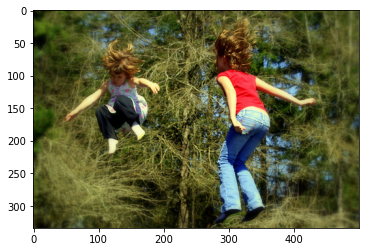

Real Caption: two girls in midair with trees in the background
Prediction Caption: two girls are jumping high in the background
BLEU-1 score: 55.55555555555556
BLEU-2 score: 45.64354645876384
BLEU-3 score: 34.84161012993529
BLEU-4 score: 5.072841446586652e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


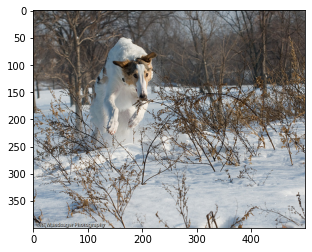

Real Caption: large white dog is bounding through snowy field
Prediction Caption: white dog jumps over twigs in the snow
BLEU-1 score: 22.22222222222222
BLEU-2 score: 16.666666666666668
BLEU-3 score: 1.7270804940051994e-91
BLEU-4 score: 6.08970970641905e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


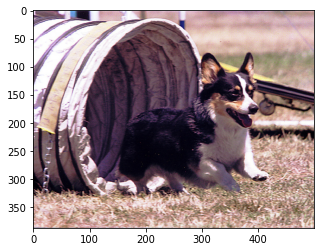

Real Caption: dog running out of tunnel on obstacle course
Prediction Caption: corgi runs out of the tunnel
BLEU-1 score: 37.1519099892935
BLEU-2 score: 23.168286407366764
BLEU-3 score: 1.9875719080152112e-91
BLEU-4 score: 6.68494960953009e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


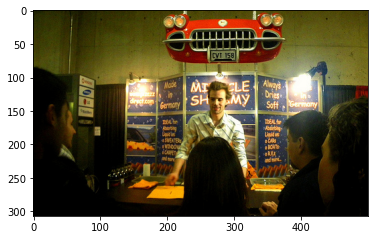

Real Caption: blonde haired man is doing demonstration in front of small crowd of people
Prediction Caption: woman walks and take pictures with product
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


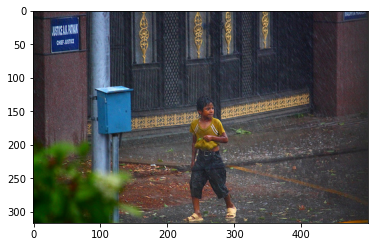

Real Caption: boy in red shirt walks down the street through heavy rain
Prediction Caption: girl walks in the sand in front of the chief office
BLEU-1 score: 25.0
BLEU-2 score: 7.458340731200295e-153
BLEU-3 score: 1.6896185209462902e-183
BLEU-4 score: 1.2882297539194153e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


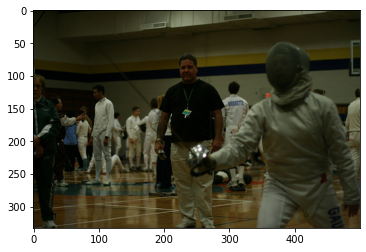

Real Caption: man is standing in gym surrounded by men fencing
Prediction Caption: man in black shirt stares at swordsman
BLEU-1 score: 22.062422564614888
BLEU-2 score: 6.581962593704787e-153
BLEU-3 score: 1.4910831112846667e-183
BLEU-4 score: 1.1368587676511997e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


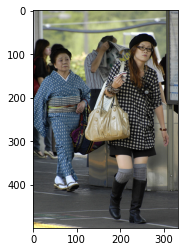

Real Caption: woman walks with her big purse
Prediction Caption: women walk down the street
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


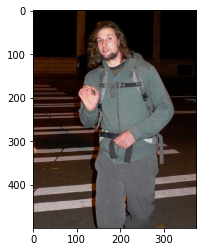

Real Caption: guy in gray is walking across the street at night
Prediction Caption: two young male with pink jacket and backpack
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


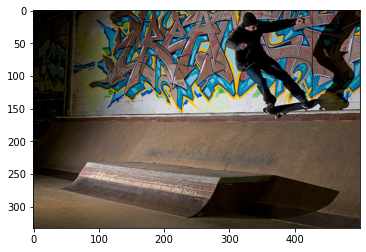

Real Caption: skateboarder is jumping through the air in front of graffiti covered wall
Prediction Caption: skateboarder is doing jump on wall covered with his shadow taking nap on ramp
BLEU-1 score: 26.666666666666668
BLEU-2 score: 13.801311186847082
BLEU-3 score: 1.5422526970585464e-91
BLEU-4 score: 5.541564466373977e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


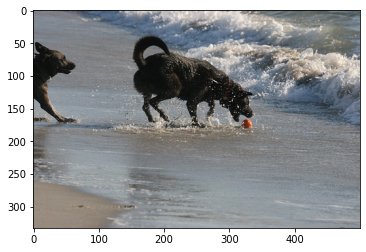

Real Caption: two dogs playing on beach with red ball while waves roll in
Prediction Caption: two black dogs playing in the sand
BLEU-1 score: 30.326532985631673
BLEU-2 score: 16.210213737276042
BLEU-3 score: 1.390649480096532e-91
BLEU-4 score: 4.6772756555248046e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


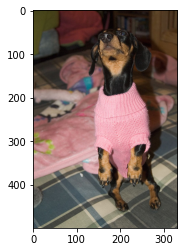

Real Caption: little puppy wearing pink sweater jumps
Prediction Caption: dog is wearing pink sweater
BLEU-1 score: 50.0
BLEU-2 score: 44.721359549995796
BLEU-3 score: 40.70905315369044
BLEU-4 score: 5.775353993361614e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


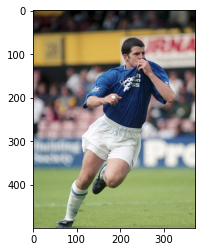

Real Caption: soccer player in blue runs
Prediction Caption: soccer player in blue jersey plays in soccer shirt is running
BLEU-1 score: 33.33333333333333
BLEU-2 score: 30.15113445777636
BLEU-3 score: 30.053232635449127
BLEU-4 score: 21.200626759025184
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


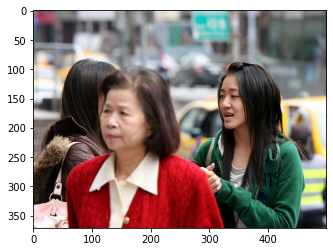

Real Caption: woman in red sweater walks past two younger women who are chatting
Prediction Caption: two lady walks by an older woman
BLEU-1 score: 22.744899739223754
BLEU-2 score: 5.540393468539137e-153
BLEU-3 score: 1.1573608787806806e-183
BLEU-4 score: 8.647068503442338e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


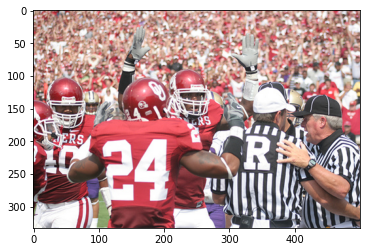

Real Caption: the red and white football team is talking with the officials
Prediction Caption: football players gather around the referees
BLEU-1 score: 16.13480348593598
BLEU-2 score: 4.5026679202702836e-153
BLEU-3 score: 9.9315714226985e-184
BLEU-4 score: 7.521821744402224e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


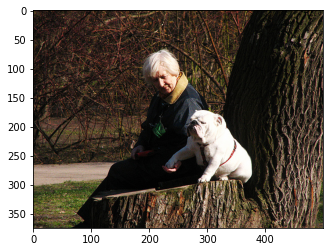

Real Caption: woman and dog sit on tree stump
Prediction Caption: the elderly woman sits on tree stump with green colored necklace on tree stump with green colored necklace on tree stump with green colored necklace on tree stump with green colored necklace
BLEU-1 score: 12.121212121212123
BLEU-2 score: 8.703882797784892
BLEU-3 score: 8.249342068276574
BLEU-4 score: 1.5270462878358646e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


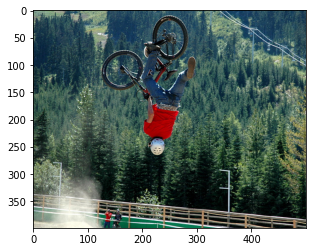

Real Caption: person flips on bike
Prediction Caption: person in red shirt and jeans is doing flip on his bike in the air
BLEU-1 score: 18.75
BLEU-2 score: 6.459112543299825e-153
BLEU-3 score: 1.549911998981145e-183
BLEU-4 score: 1.198832868637291e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


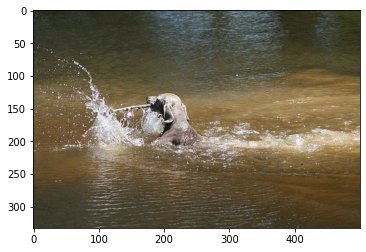

Real Caption: grey dog swimming through river with stick in his mouth
Prediction Caption: dog carries stick in mouth while in water
BLEU-1 score: 39.77063630286087
BLEU-2 score: 21.09156496639261
BLEU-3 score: 1.9026838655964305e-91
BLEU-4 score: 6.480360213743594e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


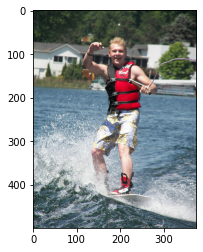

Real Caption: man wearing red life vest waves as he <unk>
Prediction Caption: guy wakeboarding one handed and smiling
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


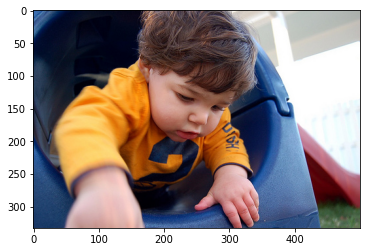

Real Caption: small boy plays in plastic blue tunnel toy
Prediction Caption: little boy in gold shirt is inside piece of blue plastic play equipment
BLEU-1 score: 28.57142857142857
BLEU-2 score: 7.973301625706313e-153
BLEU-3 score: 1.7586776545063734e-183
BLEU-4 score: 1.331960397810445e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


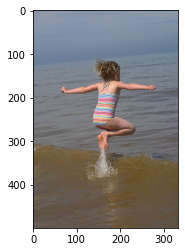

Real Caption: young girl in striped bathing suit jumping in the ocean
Prediction Caption: little girl doing handstand in the water
BLEU-1 score: 29.20502936517768
BLEU-2 score: 18.02573546715273
BLEU-3 score: 1.6379840831661966e-91
BLEU-4 score: 5.588971591971542e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


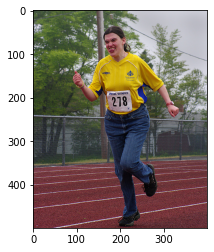

Real Caption: woman in yellow shirt running on track
Prediction Caption: woman in yellow and white swings on the court
BLEU-1 score: 40.0
BLEU-2 score: 29.81423969999719
BLEU-3 score: 25.92550634024553
BLEU-4 score: 3.965294799986402e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


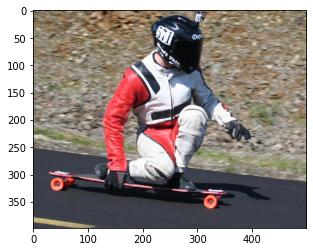

Real Caption: the boy in the red and white suit is on skateboard
Prediction Caption: someone with brown jacket and full body suit is kneeling on skateboard
BLEU-1 score: 38.46153846153847
BLEU-2 score: 25.318484177091666
BLEU-3 score: 2.2195551978722937e-91
BLEU-4 score: 7.505697654413981e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


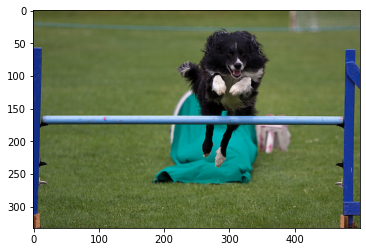

Real Caption: black dog leaping over hurdle
Prediction Caption: black and white dog jumps over bar
BLEU-1 score: 37.5
BLEU-2 score: 9.134564559628536e-153
BLEU-3 score: 1.9081654987219002e-183
BLEU-4 score: 1.4256605770826505e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


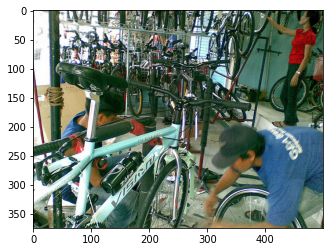

Real Caption: man is fixing the wheel of bicycle inside cycling store
Prediction Caption: man works in tree stall where two men are sitting in tree where two men are sitting in tree stall where two men are sitting in tree where two men are sitting
BLEU-1 score: 3.0303030303030303
BLEU-2 score: 2.5966609436124835e-153
BLEU-3 score: 8.971240035924835e-184
BLEU-4 score: 7.6011593754101815e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


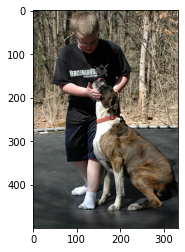

Real Caption: boy and his dog are standing on trampoline enjoying each others company
Prediction Caption: muscular dog with glasses petting tire with upturned face looking into eyes of rock
BLEU-1 score: 6.666666666666667
BLEU-2 score: 3.851470592303926e-153
BLEU-3 score: 1.1365257532669032e-183
BLEU-4 score: 9.25732495472854e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


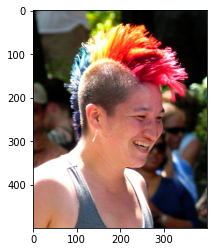

Real Caption: woman with multicolored mohawk earring and grey tank top is smiling
Prediction Caption: girl with many with colorful
BLEU-1 score: 7.243303475117973
BLEU-2 score: 2.646576928737885e-153
BLEU-3 score: 6.502033690529349e-184
BLEU-4 score: 5.058927350602078e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


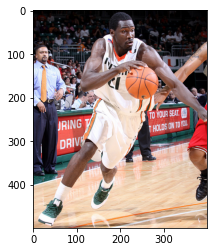

Real Caption: professional basketball player dribbles the ball around the opposing player
Prediction Caption: the man in blue has black and black pushes pushes him
BLEU-1 score: 8.333333333333332
BLEU-2 score: 4.306075028866568e-153
BLEU-3 score: 1.2152126591739945e-183
BLEU-4 score: 9.788429383461836e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


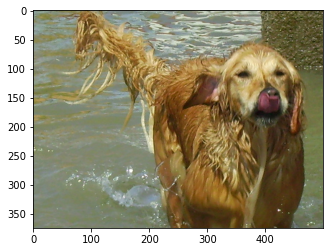

Real Caption: long haired dog walks out of the water and licks his nose
Prediction Caption: tan dog with wet hair is licking his head from water from water from water from water from water from water from water from water from water from water from water from
BLEU-1 score: 9.09090909090909
BLEU-2 score: 4.497548684366688e-153
BLEU-3 score: 1.2473514990254889e-183
BLEU-4 score: 1.0003688322288243e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


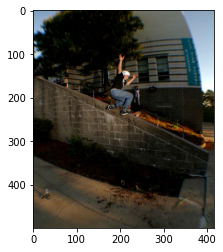

Real Caption: skateboarder goes down railing
Prediction Caption: teenager performing trick on stairway in public
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


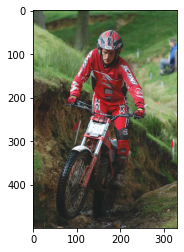

Real Caption: motorcycle racer in red jumpsuit and helmet rides up dirt hill
Prediction Caption: man in red riding gear riding red dirt bike outdoors
BLEU-1 score: 27.27272727272727
BLEU-2 score: 16.514456476895408
BLEU-3 score: 1.7175994813661398e-91
BLEU-4 score: 6.061838450024688e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


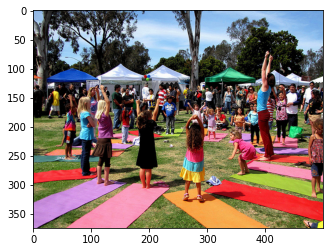

Real Caption: children learn the art of yoga on colorful mats at festival
Prediction Caption: several young girls on colorful mats stretching upwards
BLEU-1 score: 26.691246763893595
BLEU-2 score: 23.115297756211042
BLEU-3 score: 21.19367788247661
BLEU-4 score: 3.230400742863022e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


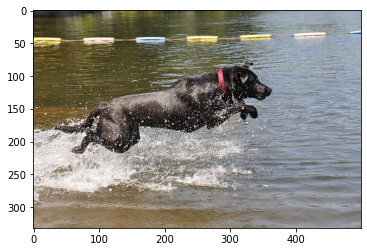

Real Caption: black dog with red collar is jumping in the water
Prediction Caption: black dog with red collar is jumping out of the water
BLEU-1 score: 75.0
BLEU-2 score: 69.08492797077574
BLEU-3 score: 65.06103783996204
BLEU-4 score: 57.06745777055999
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


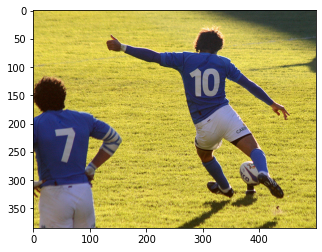

Real Caption: man in blue jersey is kicking ball while another man watches
Prediction Caption: two men in number ten is kicking the ball while another team member watches
BLEU-1 score: 46.666666666666664
BLEU-2 score: 31.62277660168379
BLEU-3 score: 23.217582333658846
BLEU-4 score: 3.617014666551307e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


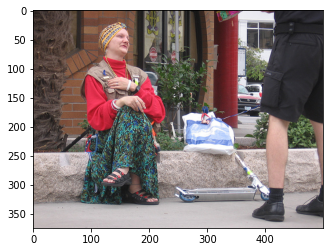

Real Caption: lady sitting down and someone with black shorts and shoes
Prediction Caption: woman in girl sit on the side of the sidewalk
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


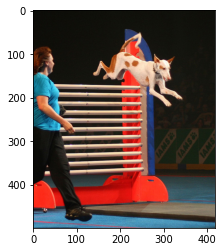

Real Caption: dog jumps over very high barrier at competition
Prediction Caption: the dog on grassy field
BLEU-1 score: 11.942188509563156
BLEU-2 score: 4.3634676769543673e-153
BLEU-3 score: 1.072004124838459e-183
BLEU-4 score: 8.34076112986429e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


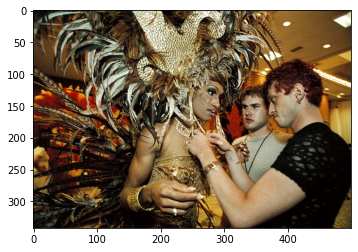

Real Caption: man is placing jewelry on an and decorated female sculpture or woman
Prediction Caption: the dancer is surrounded by parade
BLEU-1 score: 6.993452279385044
BLEU-2 score: 2.7600239552551947e-153
BLEU-3 score: 6.99305433449238e-184
BLEU-4 score: 5.483065946899793e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


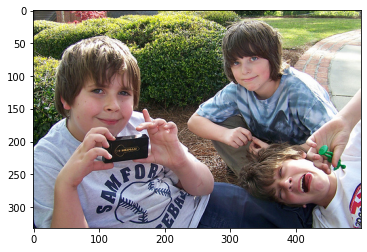

Real Caption: group of boys sits near the sidewalk and two are smiling while one makes face
Prediction Caption: three boys pose on sidewalk camera
BLEU-1 score: 9.111615923542011
BLEU-2 score: 2.542738171959617e-153
BLEU-3 score: 5.608538362412226e-184
BLEU-4 score: 4.247709049575952e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


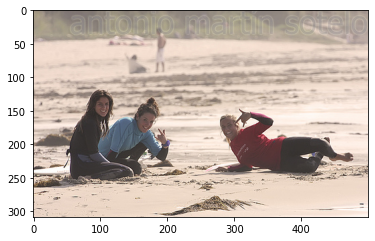

Real Caption: three girls are sitting our on the sand at the beach posing for the camera
Prediction Caption: three ladies play in the snow
BLEU-1 score: 9.111615923542011
BLEU-2 score: 2.542738171959617e-153
BLEU-3 score: 5.608538362412226e-184
BLEU-4 score: 4.247709049575952e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


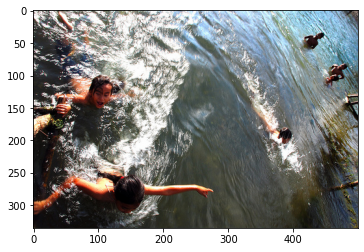

Real Caption: many children are playing and swimming in the water
Prediction Caption: the boy has blue water
BLEU-1 score: 20.21768865708778
BLEU-2 score: 5.223533056060786e-153
BLEU-3 score: 1.117179715016979e-183
BLEU-4 score: 8.396161215621529e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


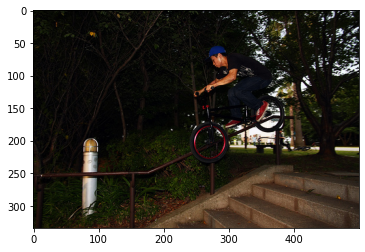

Real Caption: an asian man in black shirt and jeans rides his black and red bicycle down railing
Prediction Caption: boy wearing no shirt and black helmet is riding bike
BLEU-1 score: 17.310993243825866
BLEU-2 score: 10.482326964889737
BLEU-3 score: 1.0902229439760291e-91
BLEU-4 score: 3.8476696299631796e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


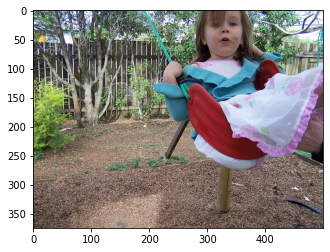

Real Caption: little girl in pink and white flowered dress and blue sweater swinging
Prediction Caption: small girl wearing dress is on swing
BLEU-1 score: 15.163266492815836
BLEU-2 score: 4.5237123240565193e-153
BLEU-3 score: 1.0248054361722373e-183
BLEU-4 score: 7.813508425061864e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


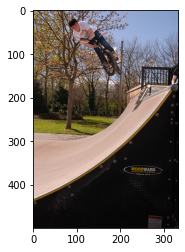

Real Caption: cyclist gets airborne on ramp
Prediction Caption: teenage boy on bike ramp
BLEU-1 score: 33.33333333333333
BLEU-2 score: 8.612150057732662e-153
BLEU-3 score: 1.8419179593432007e-183
BLEU-4 score: 1.384292958842266e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


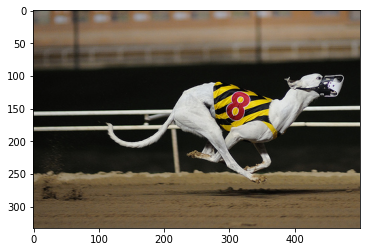

Real Caption: lean dog races along dirt track
Prediction Caption: racing white dog takes flight while wearing yellow and black jersey and muzzle
BLEU-1 score: 7.1428571428571415
BLEU-2 score: 3.986650812853149e-153
BLEU-3 score: 1.1602945388103906e-183
BLEU-4 score: 9.418382295637229e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


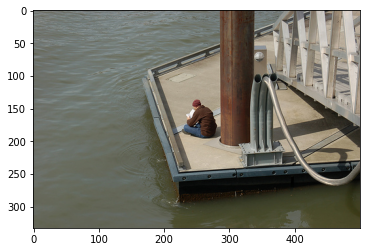

Real Caption: person in brown jacket is sitting on pier by the water reading
Prediction Caption: man reading book on the dock near post
BLEU-1 score: 23.88437701912631
BLEU-2 score: 6.17087516772532e-153
BLEU-3 score: 1.319791889377583e-183
BLEU-4 score: 9.918892480173173e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


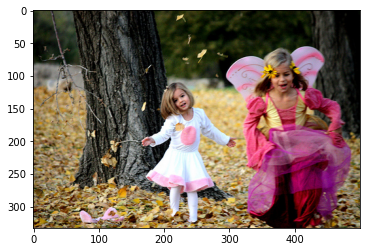

Real Caption: little girls who are dressed up play in the falling autumn leaves
Prediction Caption: two small girls dressed as and playing outdoors
BLEU-1 score: 15.922918012750872
BLEU-2 score: 5.038498475779542e-153
BLEU-3 score: 1.168632815958936e-183
BLEU-4 score: 8.962731118674859e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


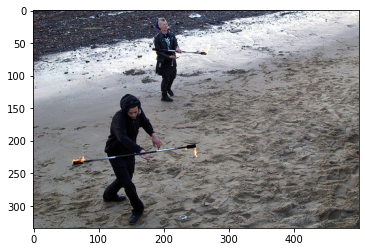

Real Caption: two people juggle fire sticks in the mud
Prediction Caption: two people stand out on the beach and hold long sticks that have flames on each end
BLEU-1 score: 22.22222222222222
BLEU-2 score: 11.433239009500591
BLEU-3 score: 1.3775421583057705e-91
BLEU-4 score: 5.043788381574437e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


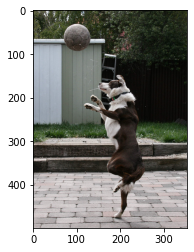

Real Caption: the brown and white dog is jumping up in an attempt to catch ball
Prediction Caption: brown and white dog is standing on its hind legs reaching for ball
BLEU-1 score: 42.857142857142854
BLEU-2 score: 36.31365196012815
BLEU-3 score: 35.92724856827829
BLEU-4 score: 27.824623288353134
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


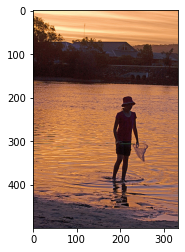

Real Caption: person holding net is standing in the water
Prediction Caption: young woman is wearing lake
BLEU-1 score: 11.942188509563156
BLEU-2 score: 4.3634676769543673e-153
BLEU-3 score: 1.072004124838459e-183
BLEU-4 score: 8.34076112986429e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


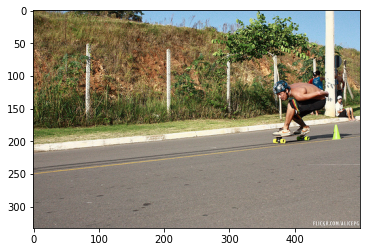

Real Caption: shirtless man skateboards down sunny roadside
Prediction Caption: man with no shirt speed skateboards downhill
BLEU-1 score: 25.0
BLEU-2 score: 7.458340731200295e-153
BLEU-3 score: 1.6896185209462902e-183
BLEU-4 score: 1.2882297539194153e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


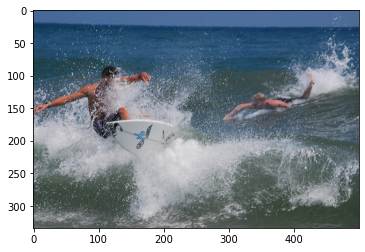

Real Caption: one man riding surfboard and one man laying on surfboard on light waves
Prediction Caption: two surfers in the ocean
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


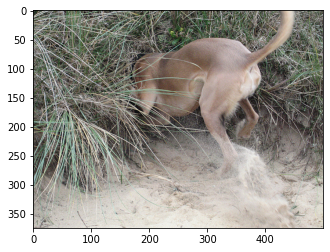

Real Caption: yellow dog digs in the sand near grass
Prediction Caption: light brown dog is poking his head into brush
BLEU-1 score: 10.000000000000002
BLEU-2 score: 4.717068855239749e-153
BLEU-3 score: 1.2835318765197404e-183
BLEU-4 score: 1.0244914152188952e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


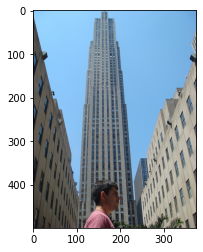

Real Caption: there is skyscraper in the distance with man walking in front of the camera
Prediction Caption: man stands in front of skyscraper
BLEU-1 score: 26.277102940817308
BLEU-2 score: 17.950678673773808
BLEU-3 score: 14.758415385028595
BLEU-4 score: 2.0988761001071138e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


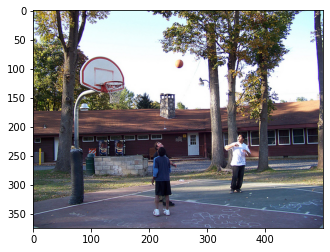

Real Caption: people playing basketball ball in air
Prediction Caption: four people stand on fenced in the other has his skateboard in suburban area
BLEU-1 score: 13.333333333333334
BLEU-2 score: 5.4468019467172e-153
BLEU-3 score: 1.3992273317570998e-183
BLEU-4 score: 1.1008876702055895e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


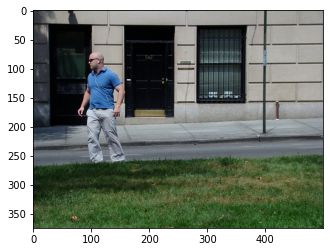

Real Caption: man in blue shirt standing on the sidewalk
Prediction Caption: man in blue shirt and her necklace and bubble
BLEU-1 score: 40.0
BLEU-2 score: 36.51483716701108
BLEU-3 score: 36.04654325043383
BLEU-4 score: 26.26909894424158
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


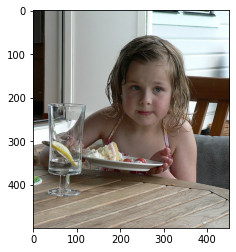

Real Caption: little girl is eating cake and <unk> at wooden table
Prediction Caption: blond haired girl sits at table
BLEU-1 score: 27.91881675133095
BLEU-2 score: 6.361471949532527e-153
BLEU-3 score: 1.2938603872273248e-183
BLEU-4 score: 9.602579706020655e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


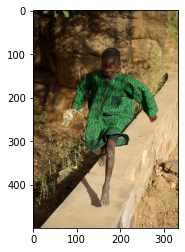

Real Caption: an african boy in large green shirt is running barefoot along wall
Prediction Caption: young boy with green shirt is running on rock ledge
BLEU-1 score: 41.50457801283011
BLEU-2 score: 33.71847857444411
BLEU-3 score: 31.986336480747912
BLEU-4 score: 22.652581507881553
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


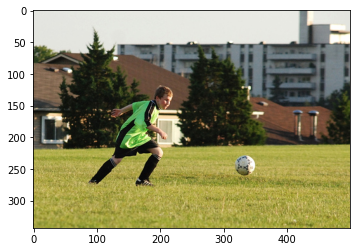

Real Caption: boy runs toward the soccer ball to kick it
Prediction Caption: boy wearing an orange soccer shirt throws soccer ball in the background
BLEU-1 score: 30.769230769230766
BLEU-2 score: 16.012815380508712
BLEU-3 score: 1.6861024029072228e-91
BLEU-4 score: 5.969061643530969e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


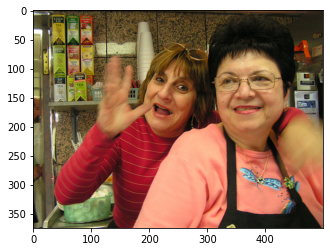

Real Caption: two women in front of boxes of tea and cups
Prediction Caption: two women are smiling together at restaurant
BLEU-1 score: 19.470019576785123
BLEU-2 score: 14.717951377637847
BLEU-3 score: 1.4503816601791856e-91
BLEU-4 score: 5.050205928624139e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


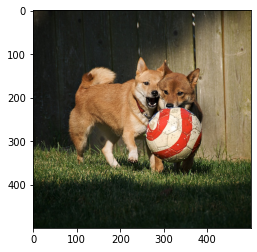

Real Caption: two brown dogs playfully chase red and white soccer ball
Prediction Caption: two dogs chasing colored play together
BLEU-1 score: 18.612544500887303
BLEU-2 score: 5.194120096460954e-153
BLEU-3 score: 1.145671313752559e-183
BLEU-4 score: 8.676910262183262e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


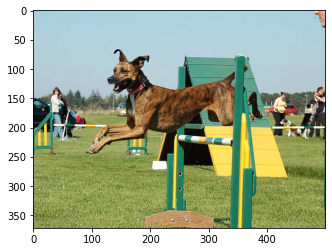

Real Caption: brown dog jumping over an obstacle hurdle
Prediction Caption: dog jumps over hurdle
BLEU-1 score: 40.21920276213836
BLEU-2 score: 7.745153834214219e-153
BLEU-3 score: 1.4727676672010504e-183
BLEU-4 score: 1.0748016968157981e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


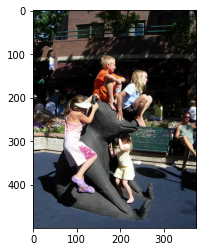

Real Caption: several children climbing on bear statue
Prediction Caption: four children climbing on statue of bear
BLEU-1 score: 62.5
BLEU-2 score: 42.25771273642582
BLEU-3 score: 34.84161012993529
BLEU-4 score: 5.072841446586652e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


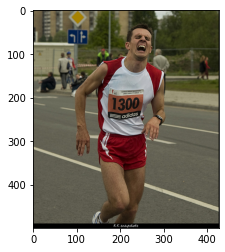

Real Caption: man looks like he in pain as he runs in race
Prediction Caption: man running
BLEU-1 score: 2.3161150407600513
BLEU-2 score: 5.98401908459915e-154
BLEU-3 score: 1.2798281668442544e-184
BLEU-4 score: 9.618545228378421e-231
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


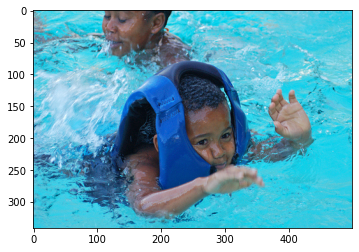

Real Caption: kid wearing life jacket in swimming pool
Prediction Caption: boy climbs rock in pool
BLEU-1 score: 28.2160574963538
BLEU-2 score: 7.290027635886345e-153
BLEU-3 score: 1.5591498913318324e-183
BLEU-4 score: 1.171778691554733e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


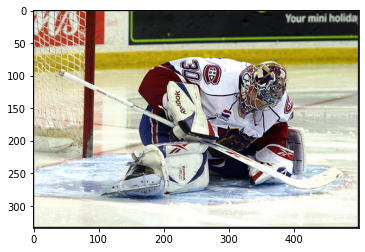

Real Caption: hockey goalie in game on the ice
Prediction Caption: hockey goalie on it and an in goal
BLEU-1 score: 44.44444444444444
BLEU-2 score: 23.570226039551585
BLEU-3 score: 2.1262855015914923e-91
BLEU-4 score: 7.241926111174567e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


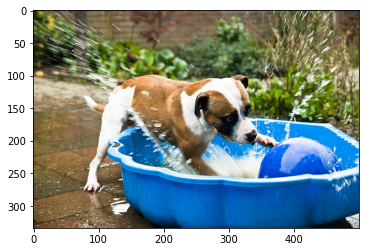

Real Caption: dog with blue ball
Prediction Caption: the white dog splashing in pool from the raft at pool
BLEU-1 score: 8.333333333333332
BLEU-2 score: 4.306075028866568e-153
BLEU-3 score: 1.2152126591739945e-183
BLEU-4 score: 9.788429383461836e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


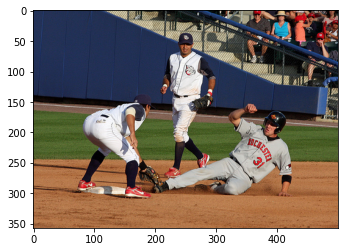

Real Caption: baseball player slides toward base
Prediction Caption: two men playing baseball
BLEU-1 score: 20.0
BLEU-2 score: 6.6709427497276e-153
BLEU-3 score: 1.5802130991274055e-183
BLEU-4 score: 1.2183324802375697e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


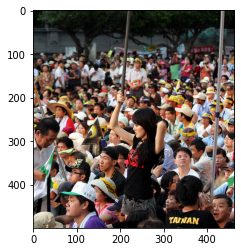

Real Caption: young woman standing above crowd
Prediction Caption: girl is showing her white and white shirt is standing with attractive woman in black shirt is on the crowd of people
BLEU-1 score: 13.043478260869565
BLEU-2 score: 5.38727226917946e-153
BLEU-3 score: 1.3900316356745895e-183
BLEU-4 score: 1.0948551819675659e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


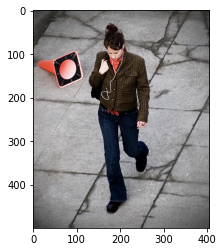

Real Caption: woman wearing headphones walks down the street
Prediction Caption: woman wearing an orange coat walks down the road
BLEU-1 score: 50.0
BLEU-2 score: 40.8248290463863
BLEU-3 score: 31.306003451477082
BLEU-4 score: 4.640083527732319e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


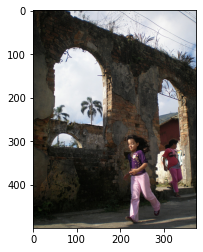

Real Caption: two girls one running away from the wall
Prediction Caption: the girl dressed in pink and black is walking by an old abandoned building
BLEU-1 score: 6.666666666666667
BLEU-2 score: 3.851470592303926e-153
BLEU-3 score: 1.1365257532669032e-183
BLEU-4 score: 9.25732495472854e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


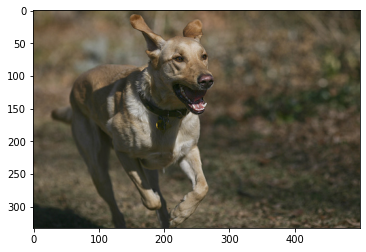

Real Caption: this dog is running along the path
Prediction Caption: tan dog with collar runs happily running with object ears in the air with bark in the air with bark in the air with bark in the air with bark in the
BLEU-1 score: 9.09090909090909
BLEU-2 score: 4.497548684366688e-153
BLEU-3 score: 1.2473514990254889e-183
BLEU-4 score: 1.0003688322288243e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


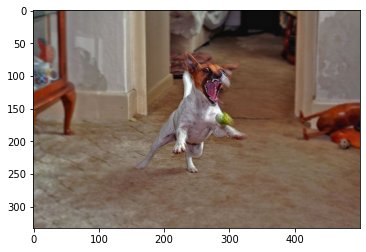

Real Caption: dog chasing ball indoors
Prediction Caption: small dog chasing sheep
BLEU-1 score: 40.0
BLEU-2 score: 31.6227766016838
BLEU-3 score: 2.536315813271983e-91
BLEU-4 score: 8.38826642100846e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


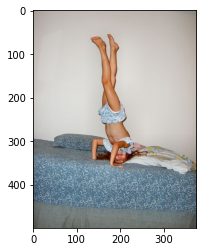

Real Caption: small child doing handstand on bed
Prediction Caption: young girl does handstand on bed with sand covered in the background
BLEU-1 score: 23.076923076923077
BLEU-2 score: 19.61161351381841
BLEU-3 score: 18.326949791536798
BLEU-4 score: 2.9699189645069594e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


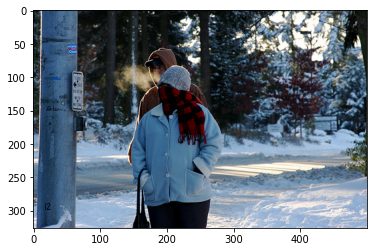

Real Caption: two people standing in the snow
Prediction Caption: two people on
BLEU-1 score: 30.326532985631673
BLEU-2 score: 24.761510494160163
BLEU-3 score: 1.793125610102159e-91
BLEU-4 score: 5.780789590099596e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


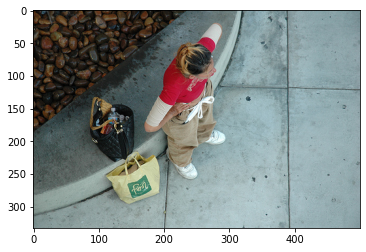

Real Caption: the woman stands in front of rock pond and wears red shirt
Prediction Caption: girl standing on her side
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


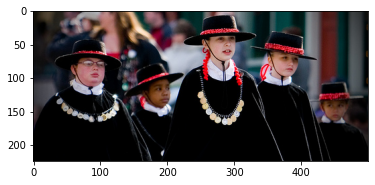

Real Caption: five children dressed in black cloaks and hats
Prediction Caption: five girls dressed alike
BLEU-1 score: 21.952465443761056
BLEU-2 score: 5.177564552024616e-153
BLEU-3 score: 1.0676968639301828e-183
BLEU-4 score: 7.951455490316087e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


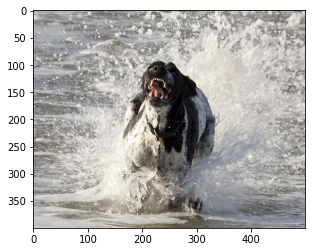

Real Caption: black and white dog is running and splashing in water
Prediction Caption: dog with the water with its mouth wide open from the water
BLEU-1 score: 15.384615384615385
BLEU-2 score: 5.850803834986753e-153
BLEU-3 score: 1.4606045589277217e-183
BLEU-4 score: 1.1409851298103346e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


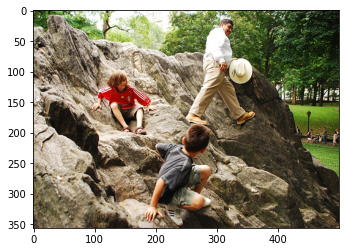

Real Caption: two boys and man holding white hat climb on rock with lawn and shade trees visible in the background
Prediction Caption: people climbing rock face while another man watch nearby
BLEU-1 score: 8.131393194811984
BLEU-2 score: 2.7122029239057673e-153
BLEU-3 score: 6.42466702029867e-184
BLEU-4 score: 4.95337021941109e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


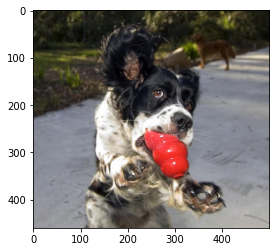

Real Caption: black and white dog has red toy in his mouth and is jumping
Prediction Caption: dog is standing on the street
BLEU-1 score: 12.124938447912854
BLEU-2 score: 3.3836527003416395e-153
BLEU-3 score: 7.463350408713334e-184
BLEU-4 score: 5.652478243478208e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


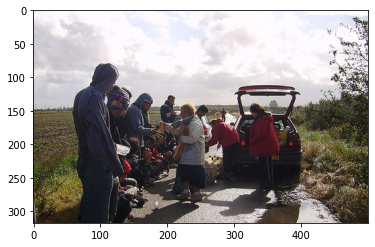

Real Caption: group of people are standing behind small <unk> vehicle out in the country
Prediction Caption: there is man on motorcycle pushes road
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


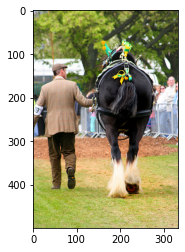

Real Caption: man in brown jacket is leading black <unk> horse
Prediction Caption: man wearing blue and black horse
BLEU-1 score: 32.206169703226536
BLEU-2 score: 7.33837135698786e-153
BLEU-3 score: 1.4925520509868707e-183
BLEU-4 score: 1.1077199809555582e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


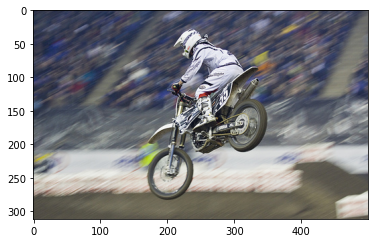

Real Caption: person in white in the air on their motorbike
Prediction Caption: motocross biker flies in the air
BLEU-1 score: 32.206169703226536
BLEU-2 score: 28.4031719055601
BLEU-3 score: 25.863985552473196
BLEU-4 score: 3.773418367399459e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


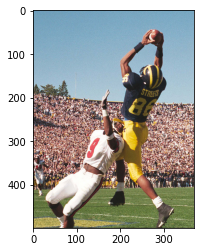

Real Caption: football player in full stadium jumping and recieving football
Prediction Caption: the american footballer in yellow catches the ball whilst under from the in white
BLEU-1 score: 6.666666666666667
BLEU-2 score: 3.851470592303926e-153
BLEU-3 score: 1.1365257532669032e-183
BLEU-4 score: 9.25732495472854e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


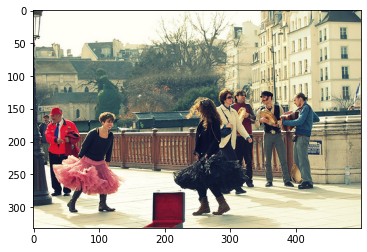

Real Caption: two women in fluffy skirts dancing to music played by men asking for money while others pass them by
Prediction Caption: group of girls in the background
BLEU-1 score: 2.5727473163993193
BLEU-2 score: 1.0153560702790748e-153
BLEU-3 score: 2.5726009206545887e-184
BLEU-4 score: 2.0171072364516604e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


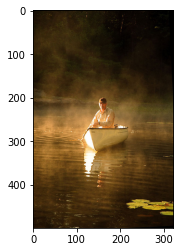

Real Caption: man in his boat on the lake
Prediction Caption: man sits in rowboat alone in rowboat alone on foggy water
BLEU-1 score: 25.0
BLEU-2 score: 7.458340731200295e-153
BLEU-3 score: 1.6896185209462902e-183
BLEU-4 score: 1.2882297539194153e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


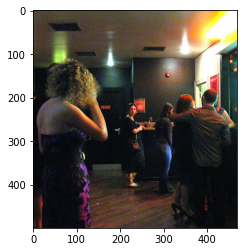

Real Caption: woman in purple dress plays with her hair while waiting in lobby
Prediction Caption: the people are gathered at table outdoors at bar
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


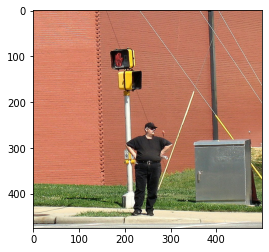

Real Caption: man dressed in black is waiting at crosswalk
Prediction Caption: man dressed in black waits at street corner at street corner at street corner at street corner at street corner at street corner at street corner at street corner at street corner
BLEU-1 score: 15.151515151515154
BLEU-2 score: 11.918282365569906
BLEU-3 score: 12.263902603277616
BLEU-4 score: 7.434360163166209
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


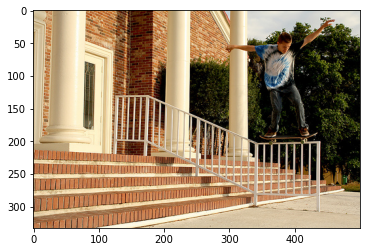

Real Caption: boy in tie dyed shirt is riding skateboard down railing
Prediction Caption: teenage boy wearing black short sleeved steps
BLEU-1 score: 9.735009788392563
BLEU-2 score: 4.1072732976237013e-153
BLEU-3 score: 1.0688236188553917e-183
BLEU-4 score: 8.436497969708995e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


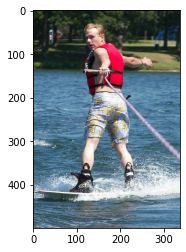

Real Caption: man wearing red life jacked is holding purple rope while waterskiing
Prediction Caption: man dressed in the white trunks jumping in an swim trunks is falling backwards
BLEU-1 score: 13.333333333333334
BLEU-2 score: 5.4468019467172e-153
BLEU-3 score: 1.3992273317570998e-183
BLEU-4 score: 1.1008876702055895e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


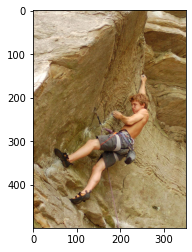

Real Caption: the boy looked down as he climbed the steep rock face
Prediction Caption: boy climbing rock
BLEU-1 score: 8.688697172522257
BLEU-2 score: 1.8329130973442954e-153
BLEU-3 score: 3.6147837129061025e-184
BLEU-4 score: 2.6621681380487263e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


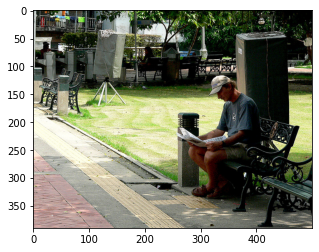

Real Caption: man reads the paper on wood an iron park bench
Prediction Caption: man and woman stands on bench reading reading paper
BLEU-1 score: 40.0
BLEU-2 score: 9.434137710479516e-153
BLEU-3 score: 1.9454705288851736e-183
BLEU-4 score: 1.4488496539373276e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


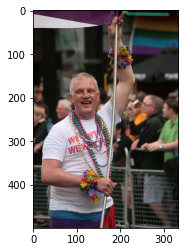

Real Caption: man in white with red logo is wearing colored beads whilst carrying flag past row of spectators
Prediction Caption: woman wearing mardi <unk> beads around her neck
BLEU-1 score: 9.135828677937498
BLEU-2 score: 2.8908557358588535e-153
BLEU-3 score: 6.705070757424583e-184
BLEU-4 score: 5.142397638489538e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


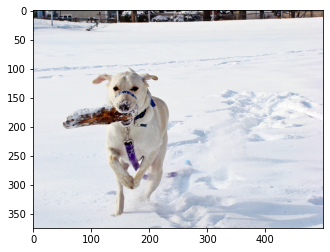

Real Caption: white dog carries something in its mouth through the snow
Prediction Caption: white dog with log in the snow
BLEU-1 score: 48.67504894196281
BLEU-2 score: 32.91033976993491
BLEU-3 score: 2.3505706052916426e-91
BLEU-4 score: 7.551819280284158e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


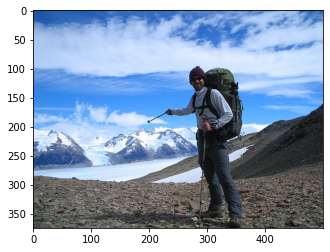

Real Caption: hiker poses for picture in front of stunning mountains and clouds
Prediction Caption: hiker poses for the mountains
BLEU-1 score: 28.973213900471883
BLEU-2 score: 22.442554984526566
BLEU-3 score: 19.286816745371354
BLEU-4 score: 2.6971259331602326e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


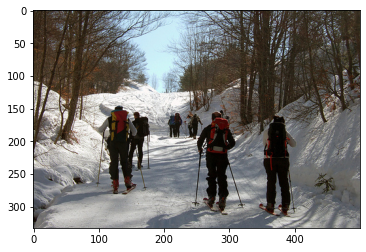

Real Caption: skiers walking up the slope
Prediction Caption: group of skiers following path through the winter
BLEU-1 score: 22.22222222222222
BLEU-2 score: 7.031791076575252e-153
BLEU-3 score: 1.6309584783156365e-183
BLEU-4 score: 1.2508498911928378e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


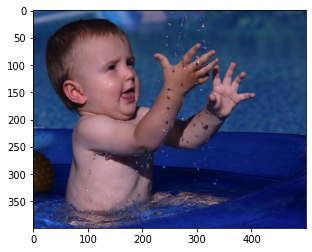

Real Caption: young boy catching stream of water
Prediction Caption: baby the water water splashing water in pool with water toy in pool with water water shooting up pool
BLEU-1 score: 5.000000000000001
BLEU-2 score: 3.335471374863794e-153
BLEU-3 score: 1.0425518425027685e-183
BLEU-4 score: 8.614911585158346e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


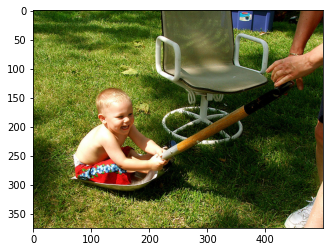

Real Caption: small boy in red shorts with blue flowers sitting on shovel in the grass near tan chair
Prediction Caption: boy being pulled on shovel
BLEU-1 score: 7.993987303984694
BLEU-2 score: 5.055841493412091
BLEU-3 score: 4.0550552820383696e-92
BLEU-4 score: 1.341113905439655e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


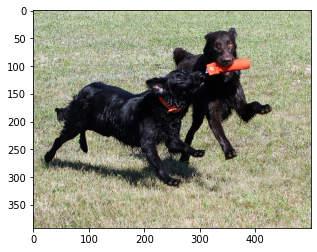

Real Caption: two dark dogs run together and one holds something in its mouth
Prediction Caption: two black dogs playing with orange object run across grass
BLEU-1 score: 24.902746807698065
BLEU-2 score: 7.113038902664186e-153
BLEU-3 score: 1.5835942390985683e-183
BLEU-4 score: 1.2021513525930774e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


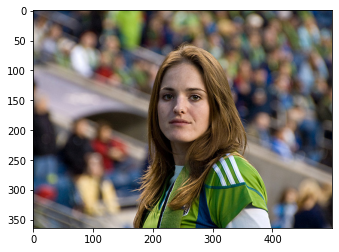

Real Caption: girl in green looks at the camera and stands in front of huge crowd of <unk> faces
Prediction Caption: brown haired child wearing fuzzy black striped shirt and white shirt
BLEU-1 score: 5.49367191833703
BLEU-2 score: 2.83873961572039e-153
BLEU-3 score: 8.011175592614212e-184
BLEU-4 score: 6.452930355425921e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


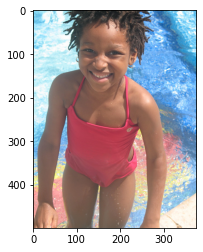

Real Caption: young girl in red bathing suit at the edge of the pool
Prediction Caption: little girl in pink bathing suit laughs by pool
BLEU-1 score: 40.936537653899094
BLEU-2 score: 27.2910251025994
BLEU-3 score: 2.143244313942668e-91
BLEU-4 score: 7.051032102388049e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


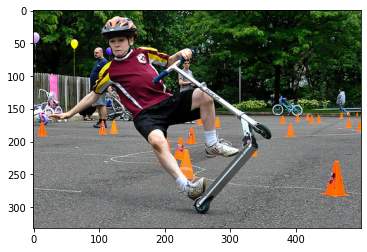

Real Caption: boy wearing helmet flips up his scooter as he skates between orange cones
Prediction Caption: someone dressed alike sit on scooter
BLEU-1 score: 6.062469223956427
BLEU-2 score: 2.392603769591812e-153
BLEU-3 score: 6.062124254323657e-184
BLEU-4 score: 4.753148692240233e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


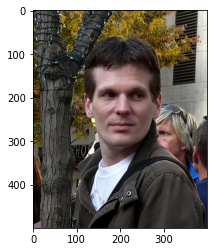

Real Caption: man in brown jacket and white shirt looks to his side
Prediction Caption: small child in jacket looks to his right while looking at camera
BLEU-1 score: 38.46153846153847
BLEU-2 score: 25.318484177091666
BLEU-3 score: 21.362142852538657
BLEU-4 score: 3.374479444311902e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


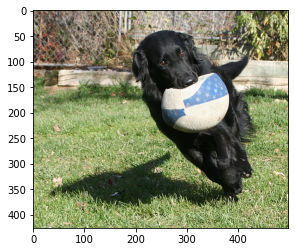

Real Caption: black dog runs with ball in its mouth
Prediction Caption: the black dog is carrying blue and white ball in its mouth
BLEU-1 score: 46.15384615384615
BLEU-2 score: 39.22322702763681
BLEU-3 score: 34.19929757948489
BLEU-4 score: 22.997519112894445
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


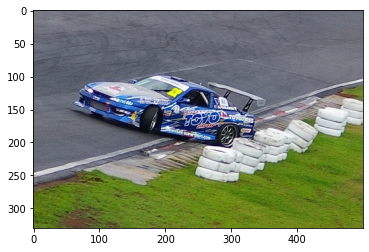

Real Caption: blue race car slides off the racetrack and hits white <unk> <unk> with its rear
Prediction Caption: blue race car on the course
BLEU-1 score: 18.223231847084023
BLEU-2 score: 13.918223224332078
BLEU-3 score: 11.965329341867346
BLEU-4 score: 1.720747828512377e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


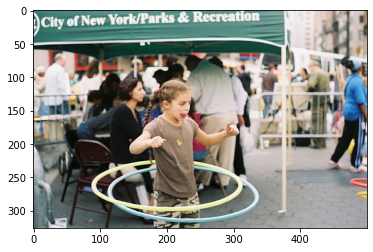

Real Caption: young girl uses two hula hoops
Prediction Caption: boy in dress is hula hoops in crowded area looking at an event
BLEU-1 score: 14.285714285714285
BLEU-2 score: 10.482848367219184
BLEU-3 score: 1.3076481741058403e-91
BLEU-4 score: 4.829607837557234e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


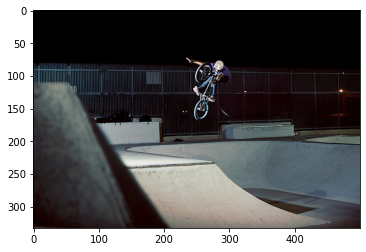

Real Caption: bicyclist rides on ramps
Prediction Caption: man performs bike trick on ramp
BLEU-1 score: 14.285714285714285
BLEU-2 score: 5.637975647982814e-153
BLEU-3 score: 1.4284901392909564e-183
BLEU-4 score: 1.1200407237786664e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


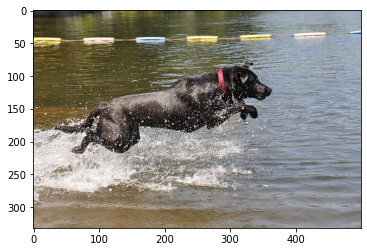

Real Caption: black dog with red collar is jumping in the water
Prediction Caption: black dog with red collar is jumping out of the water
BLEU-1 score: 75.0
BLEU-2 score: 69.08492797077574
BLEU-3 score: 65.06103783996204
BLEU-4 score: 57.06745777055999
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


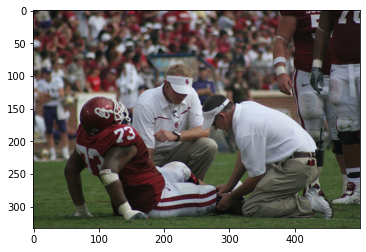

Real Caption: football player in red jersey getting his knee looked at by another man
Prediction Caption: two football player is being on the field in front of game
BLEU-1 score: 23.076923076923077
BLEU-2 score: 13.867504905630728
BLEU-3 score: 1.5466866120248002e-91
BLEU-4 score: 5.554837769749797e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


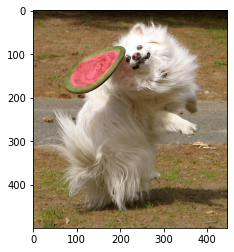

Real Caption: the dog is trying to catch frisbee
Prediction Caption: white dog with long hair dog
BLEU-1 score: 14.285714285714285
BLEU-2 score: 5.637975647982814e-153
BLEU-3 score: 1.4284901392909564e-183
BLEU-4 score: 1.1200407237786664e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


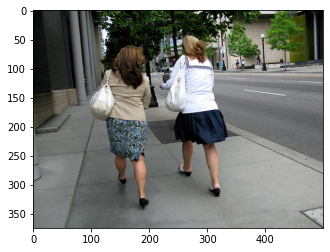

Real Caption: two women wearing skirts and heels walking down sidewalk
Prediction Caption: two women in skirts walking on the sidewalk
BLEU-1 score: 55.55555555555556
BLEU-2 score: 26.352313834736496
BLEU-3 score: 2.2734980277612575e-91
BLEU-4 score: 7.657404561915943e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


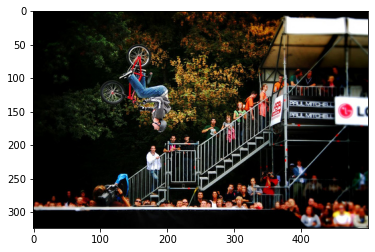

Real Caption: the athlete <unk> trick as the large crown watched
Prediction Caption: the boy jumps high wheel
BLEU-1 score: 10.10884432854389
BLEU-2 score: 3.693595645692774e-153
BLEU-3 score: 9.074319006831119e-184
BLEU-4 score: 7.060301868108111e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


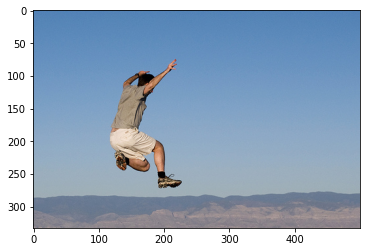

Real Caption: man in gray shirt jumps in the air
Prediction Caption: man is jumping in the background
BLEU-1 score: 37.1519099892935
BLEU-2 score: 23.168286407366764
BLEU-3 score: 1.9875719080152112e-91
BLEU-4 score: 6.68494960953009e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


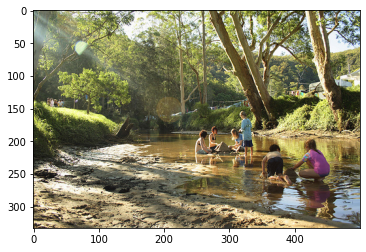

Real Caption: six people are sitting in shallow creek making mud castles
Prediction Caption: six children are playing around around around around around around around around around around around around around around around around around around around around around around around around around around around around
BLEU-1 score: 6.060606060606061
BLEU-2 score: 3.6722331233414005e-153
BLEU-3 score: 1.1044892051005175e-183
BLEU-4 score: 9.039352811507815e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


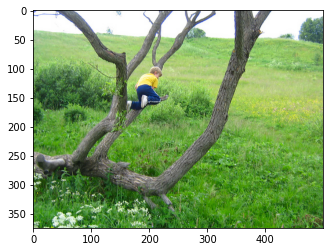

Real Caption: boy wearing yellow shirt and blue pants is climbing tree in hilly area
Prediction Caption: blond child is laying on branch of tree in green field
BLEU-1 score: 23.001110365733084
BLEU-2 score: 13.870191426307436
BLEU-3 score: 1.496154074549692e-91
BLEU-4 score: 5.328657904195398e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


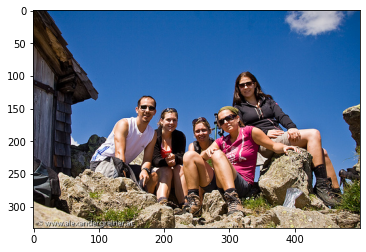

Real Caption: four women and one men sitting on some rocks wooden house to the left
Prediction Caption: group of women sit on rocks in the rocks near wooden shed
BLEU-1 score: 35.61388764008908
BLEU-2 score: 8.566004020153672e-153
BLEU-3 score: 1.7803581894868447e-183
BLEU-4 score: 1.328488253493217e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


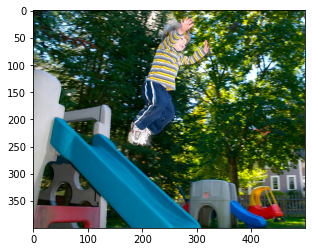

Real Caption: child jumps over the slide <unk> of playground equipment shaded by trees
Prediction Caption: little boy is jumping off the top of slide
BLEU-1 score: 24.561922592339457
BLEU-2 score: 6.689196389553559e-153
BLEU-3 score: 1.4611141238590901e-183
BLEU-4 score: 1.1039000191006553e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


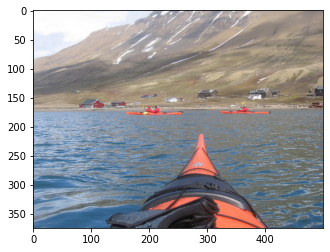

Real Caption: several orange kayakers row in mountain lake
Prediction Caption: someone takes dive into the water
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


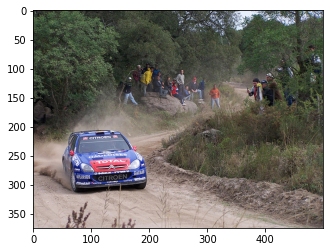

Real Caption: racing car goes through dirt course while fans watch
Prediction Caption: four blue race car on trail while people are racing on trail while onlookers watch
BLEU-1 score: 25.0
BLEU-2 score: 7.458340731200295e-153
BLEU-3 score: 1.6896185209462902e-183
BLEU-4 score: 1.2882297539194153e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


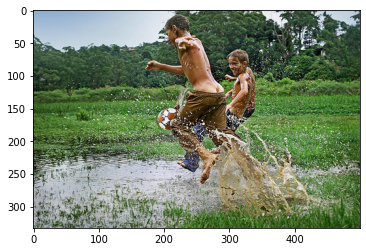

Real Caption: two young boys playing with soccer ball in pond in the middle of grassy field
Prediction Caption: two boys play soccer in muddy water
BLEU-1 score: 20.84310098392542
BLEU-2 score: 4.3969299452079405e-153
BLEU-3 score: 8.671415341925103e-184
BLEU-4 score: 6.386209374751479e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


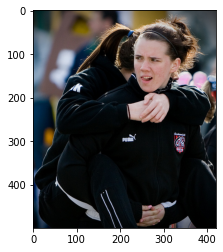

Real Caption: woman carrying another woman wearing matching exercise attire on her back
Prediction Caption: female soccer player gives teammate piggyback ride
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


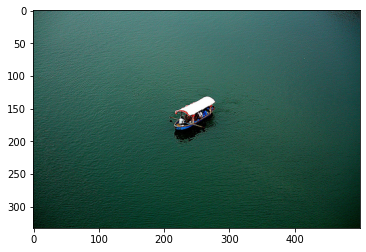

Real Caption: boat with roof on green water
Prediction Caption: the boat floats on the lake
BLEU-1 score: 28.57142857142857
BLEU-2 score: 7.973301625706313e-153
BLEU-3 score: 1.7586776545063734e-183
BLEU-4 score: 1.331960397810445e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


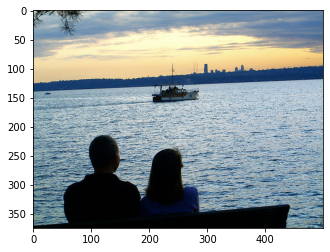

Real Caption: couple watches boat against skyline
Prediction Caption: two people watching boat sail past
BLEU-1 score: 14.285714285714285
BLEU-2 score: 5.637975647982814e-153
BLEU-3 score: 1.4284901392909564e-183
BLEU-4 score: 1.1200407237786664e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


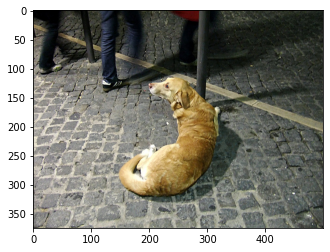

Real Caption: yellow dog is lying near where people are walking
Prediction Caption: dog plays with brick wall
BLEU-1 score: 10.10884432854389
BLEU-2 score: 3.693595645692774e-153
BLEU-3 score: 9.074319006831119e-184
BLEU-4 score: 7.060301868108111e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


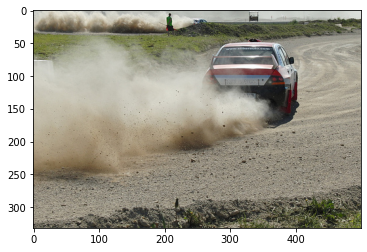

Real Caption: red and white race car racing on dirt racetrack
Prediction Caption: red and white race car throws up dust behind it as drives away down the trail made of dust behind it as drives away down the trail made of dust behind it
BLEU-1 score: 15.151515151515154
BLEU-2 score: 13.76204706407951
BLEU-3 score: 15.098635175831415
BLEU-4 score: 10.51377297031591
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


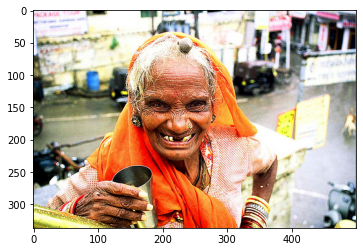

Real Caption: an elderly indian lady is wearing an orange headscarf and <unk>
Prediction Caption: an elderly woman smiles for the camera
BLEU-1 score: 17.182231969774307
BLEU-2 score: 12.988546503156082
BLEU-3 score: 1.2799573226736345e-91
BLEU-4 score: 4.456791089425162e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


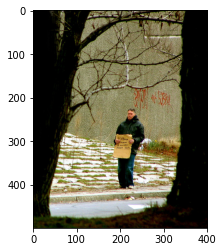

Real Caption: man in black jacket is standing between two trees holding up sign
Prediction Caption: man stands with cardboard sign
BLEU-1 score: 12.262648039048077
BLEU-2 score: 3.168232950523297e-153
BLEU-3 score: 6.776037495668201e-184
BLEU-4 score: 5.092529201164552e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


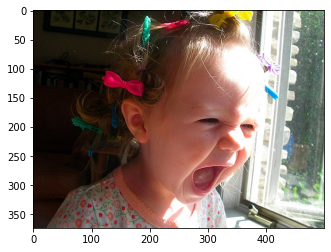

Real Caption: young girl with hair ribbons yawning
Prediction Caption: toddler dressed in butterfly on her
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


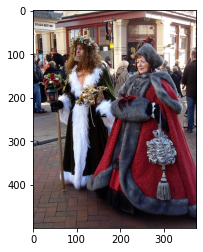

Real Caption: man and woman wear fur coats while walking down brick road
Prediction Caption: women wearing elaborate gold pants
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


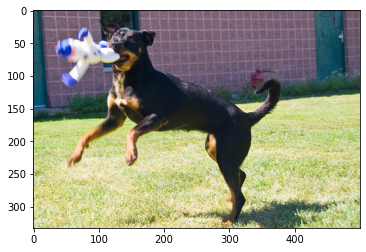

Real Caption: dog playing with its toy
Prediction Caption: dog with blue dog reaches close together
BLEU-1 score: 25.0
BLEU-2 score: 7.458340731200295e-153
BLEU-3 score: 1.6896185209462902e-183
BLEU-4 score: 1.2882297539194153e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


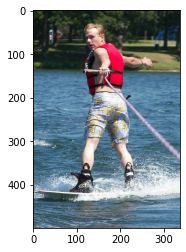

Real Caption: man wearing red life jacked is holding purple rope while waterskiing
Prediction Caption: man dressed in the white trunks jumping in an swim trunks is falling backwards
BLEU-1 score: 13.333333333333334
BLEU-2 score: 5.4468019467172e-153
BLEU-3 score: 1.3992273317570998e-183
BLEU-4 score: 1.1008876702055895e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


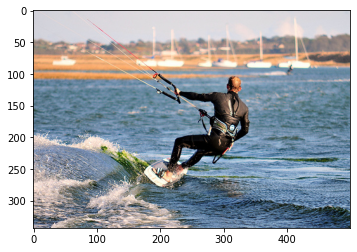

Real Caption: man waterskis while attached to parachute
Prediction Caption: this boy is standing on the shore of the water
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


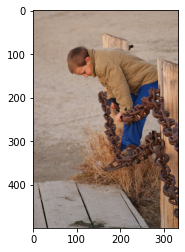

Real Caption: boy in brown jacket is standing on chains between two wooden posts
Prediction Caption: boy climbing on chain fence
BLEU-1 score: 12.262648039048077
BLEU-2 score: 3.168232950523297e-153
BLEU-3 score: 6.776037495668201e-184
BLEU-4 score: 5.092529201164552e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


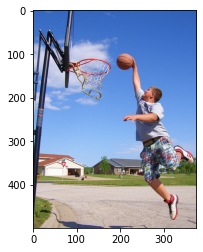

Real Caption: boy dunks basketball
Prediction Caption: boy dunks basketball and white ball
BLEU-1 score: 42.857142857142854
BLEU-2 score: 37.79644730092272
BLEU-3 score: 34.41752104927812
BLEU-4 score: 5.021333847570327e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


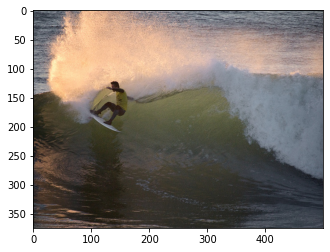

Real Caption: surfer in yellow shirt is riding wave that is reflecting sunlight
Prediction Caption: surfer is riding on breaking wave
BLEU-1 score: 32.26960697187196
BLEU-2 score: 17.42757960201972
BLEU-3 score: 1.411491490766853e-91
BLEU-4 score: 4.679577191845681e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


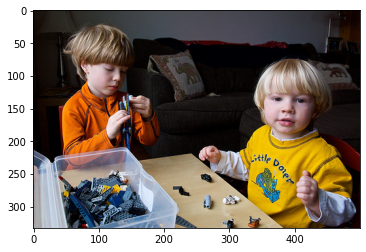

Real Caption: the boys are playing with legos
Prediction Caption: two boys play with legos
BLEU-1 score: 50.0
BLEU-2 score: 31.6227766016838
BLEU-3 score: 2.536315813271983e-91
BLEU-4 score: 8.38826642100846e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


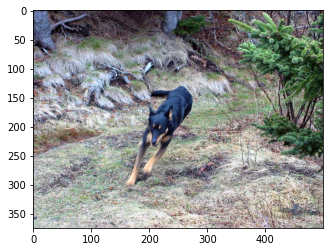

Real Caption: black dog running through the forest
Prediction Caption: dog is running through forest
BLEU-1 score: 66.66666666666666
BLEU-2 score: 36.51483716701108
BLEU-3 score: 2.764935154957498e-91
BLEU-4 score: 9.013778876140909e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


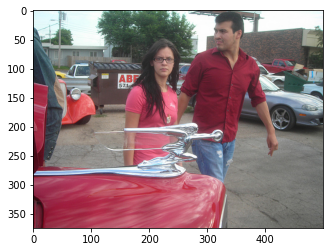

Real Caption: man and woman walk past red car with silver hood ornament
Prediction Caption: man and woman walking next to red car with an unusual hood ornament
BLEU-1 score: 57.14285714285714
BLEU-2 score: 46.88072309384954
BLEU-3 score: 37.08098020915335
BLEU-4 score: 5.3431263738429207e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


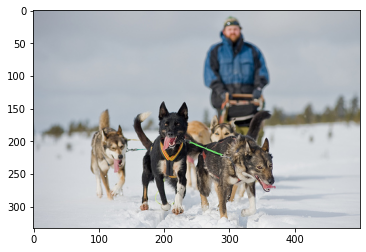

Real Caption: man in blue jacket riding dog sled over snow covered plain
Prediction Caption: five dogs pull man on sled through the snow
BLEU-1 score: 27.145122541078788
BLEU-2 score: 7.392705315031213e-153
BLEU-3 score: 1.614780837678646e-183
BLEU-4 score: 1.2199981975731961e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


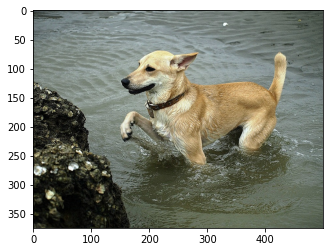

Real Caption: yellow dog in shallow water
Prediction Caption: naked dog is about shaking water with its mouth
BLEU-1 score: 20.0
BLEU-2 score: 6.6709427497276e-153
BLEU-3 score: 1.5802130991274055e-183
BLEU-4 score: 1.2183324802375697e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


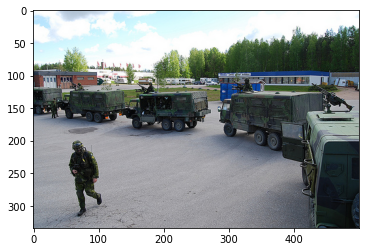

Real Caption: army vehicles line up and soldier walks near them
Prediction Caption: of military trucks are lined up in lot
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


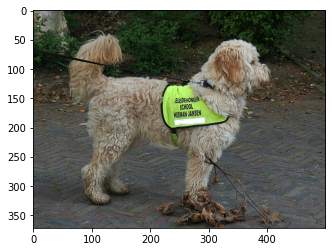

Real Caption: fluffy dog is wearing green guard jacket for an <unk> school
Prediction Caption: white puddle wearing yellow school jacket on lease
BLEU-1 score: 26.691246763893595
BLEU-2 score: 6.89607067075869e-153
BLEU-3 score: 1.4748926031503012e-183
BLEU-4 score: 1.1084551487393798e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


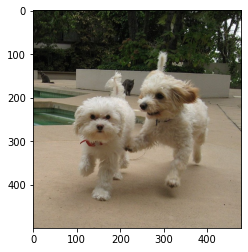

Real Caption: two little white dogs running
Prediction Caption: two white dogs with cats in the background
BLEU-1 score: 33.33333333333333
BLEU-2 score: 20.412414523193153
BLEU-3 score: 1.9504730631920925e-91
BLEU-4 score: 6.7393716283177e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


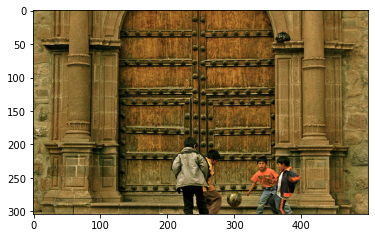

Real Caption: four boys playing game with soccer ball in front of large set of ornate doors
Prediction Caption: children play soccer in front of large wooden door
BLEU-1 score: 30.326532985631673
BLEU-2 score: 24.761510494160163
BLEU-3 score: 23.377032818334268
BLEU-4 score: 16.847111051295393
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


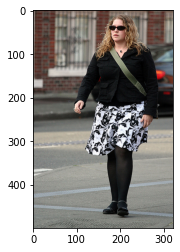

Real Caption: woman in black and sunglasses standing in road
Prediction Caption: woman in dark jacket and black and white skirt walks down the street
BLEU-1 score: 28.57142857142857
BLEU-2 score: 20.965696734438367
BLEU-3 score: 1.9820240006592639e-91
BLEU-4 score: 6.830096904817037e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


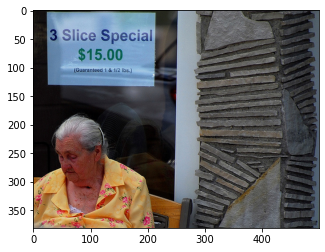

Real Caption: an older woman sits under sign advertising slice special
Prediction Caption: woman in yellow shirt is sitting by wooden bench
BLEU-1 score: 10.000000000000002
BLEU-2 score: 4.717068855239749e-153
BLEU-3 score: 1.2835318765197404e-183
BLEU-4 score: 1.0244914152188952e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


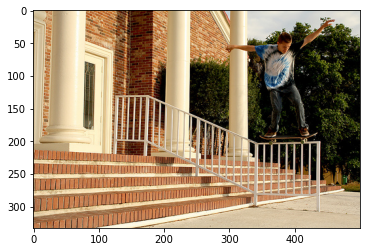

Real Caption: skateboarder goes down stair railing
Prediction Caption: teenage boy wearing black short sleeved steps
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


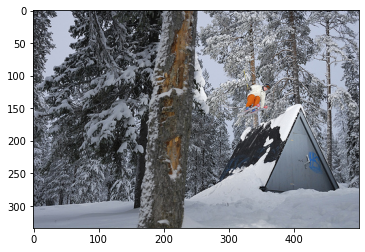

Real Caption: person ski jumps off an frame shack
Prediction Caption: the skier wearing orange pants is jumping over the wooden roof
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


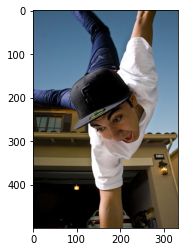

Real Caption: person balances on one hand
Prediction Caption: the boy doing handstand in public
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


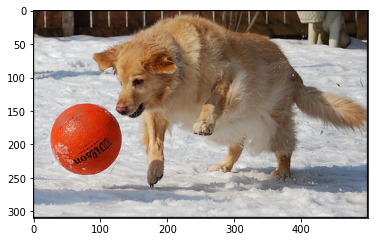

Real Caption: the yellow dog is in the snow with red ball
Prediction Caption: dog in pink tent at an expanse of the pink frisbee in the snow
BLEU-1 score: 33.33333333333333
BLEU-2 score: 21.821789023599234
BLEU-3 score: 18.5845138912132
BLEU-4 score: 3.0046607657263396e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


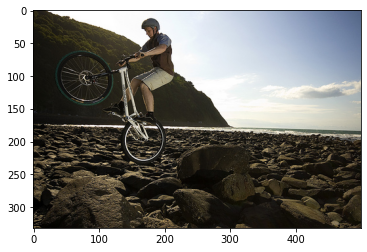

Real Caption: man on white bike doing tricks on rocky ground
Prediction Caption: guy on his bike doing truck on rocky beach
BLEU-1 score: 50.0
BLEU-2 score: 33.33333333333333
BLEU-3 score: 2.617764516460675e-91
BLEU-4 score: 8.612150057732662e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


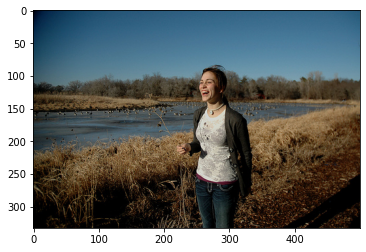

Real Caption: woman standing in front of water and dry grass smiles
Prediction Caption: the smiling woman stands in grass near creek
BLEU-1 score: 29.827977227145652
BLEU-2 score: 7.70649047396433e-153
BLEU-3 score: 1.6482206083667876e-183
BLEU-4 score: 1.2387197655613556e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


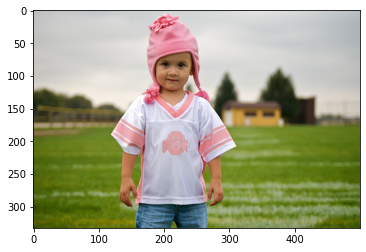

Real Caption: little girl in football <unk> and pink snow hat is standing on football field
Prediction Caption: boy wearing pink hat bluejeans and white shirt standing in grass
BLEU-1 score: 35.27007187044225
BLEU-2 score: 8.150498675847148e-153
BLEU-3 score: 1.6670970103844601e-183
BLEU-4 score: 1.2390051155620428e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


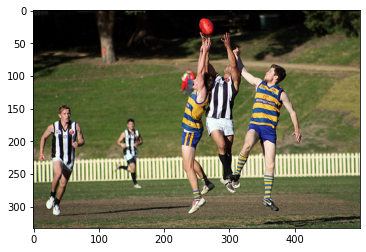

Real Caption: three rugby players all trying to catch ball
Prediction Caption: five young men playing rugby
BLEU-1 score: 11.942188509563156
BLEU-2 score: 4.3634676769543673e-153
BLEU-3 score: 1.072004124838459e-183
BLEU-4 score: 8.34076112986429e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


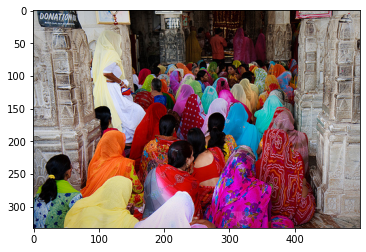

Real Caption: crowd of women wearing multiple different colors is entering stone structure
Prediction Caption: many ethnic people in robes gather for an event
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


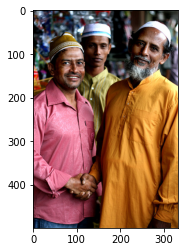

Real Caption: man in bright pink shirt shakes the hand of bearded man in <unk> shirt
Prediction Caption: dark skinned men in shirts is looking at their camera
BLEU-1 score: 6.920912606335215
BLEU-2 score: 3.423985552596375e-153
BLEU-3 score: 9.496091785550296e-184
BLEU-4 score: 7.615811788153039e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


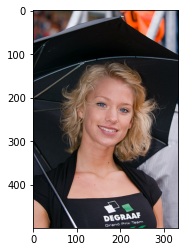

Real Caption: lady posing while holding an umbrella
Prediction Caption: the girl on dog
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


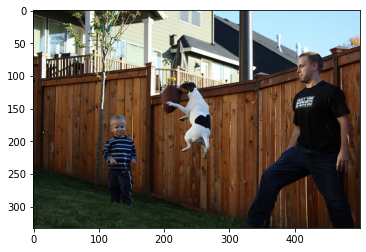

Real Caption: small black brown and white dog catches football in midair as man and child look on
Prediction Caption: the black short brown and white shirt is standing near dog who is standing near dog who is standing near dog who is standing near dog who is standing near dog who
BLEU-1 score: 15.151515151515154
BLEU-2 score: 9.731236802019039
BLEU-3 score: 8.820481966564184
BLEU-4 score: 1.6146548627012024e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


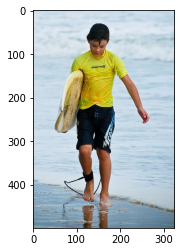

Real Caption: young boy wearing yellow shirt walking on the beach carrying surfboard
Prediction Caption: boy in yellow shirt is walking on the beach holds surfboard
BLEU-1 score: 66.66666666666666
BLEU-2 score: 49.236596391733094
BLEU-3 score: 40.334976925681346
BLEU-4 score: 27.091988546756284
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


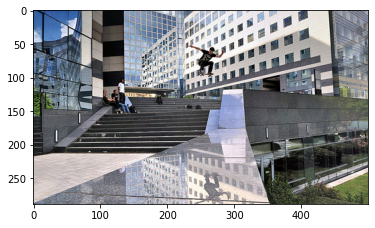

Real Caption: skateboarder leaps of steps outside <unk> building
Prediction Caption: skateboarder flies through the air over the staircase of sleek building
BLEU-1 score: 25.0
BLEU-2 score: 7.458340731200295e-153
BLEU-3 score: 1.6896185209462902e-183
BLEU-4 score: 1.2882297539194153e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


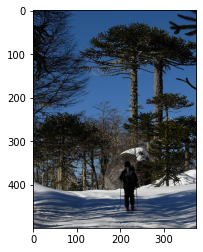

Real Caption: lone skier walks through the snow
Prediction Caption: skier following path
BLEU-1 score: 15.163266492815836
BLEU-2 score: 4.5237123240565193e-153
BLEU-3 score: 1.0248054361722373e-183
BLEU-4 score: 7.813508425061864e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


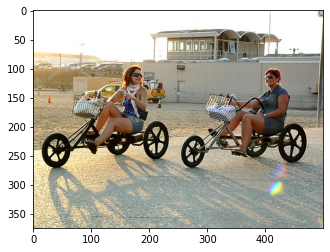

Real Caption: two women in summer wear ride beach cruiser tricycles on the concrete near the beach
Prediction Caption: two women are in red poses with their bicycles together in the their bikes in red poses with their bicycles together in the their bikes in red poses with their
BLEU-1 score: 16.129032258064512
BLEU-2 score: 7.332355751067662
BLEU-3 score: 1.0552356286192104e-91
BLEU-4 score: 4.039187183453553e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


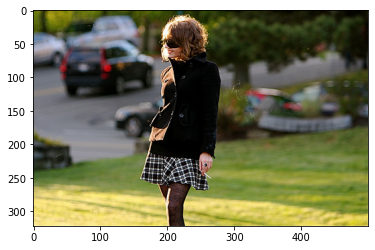

Real Caption: woman dressed in black and white smokes cigarette in grassy area
Prediction Caption: curly redheaded girl wearing white jacket standing by playground
BLEU-1 score: 9.048374180359598
BLEU-2 score: 4.2681804036729734e-153
BLEU-3 score: 1.1613876691169721e-183
BLEU-4 score: 9.269981669466711e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


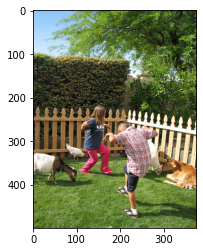

Real Caption: the children in the scene are in petting zoo and are acting like duck or chicken
Prediction Caption: two children play together outside with farm animals
BLEU-1 score: 5.104731378176962
BLEU-2 score: 2.284369557581617e-153
BLEU-3 score: 6.086243293203436e-184
BLEU-4 score: 4.832402486973384e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


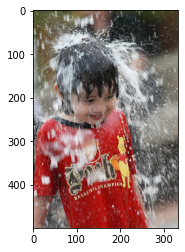

Real Caption: little kid in red pooh shirt getting wet
Prediction Caption: the little boy in red is getting drenched with water
BLEU-1 score: 36.36363636363637
BLEU-2 score: 19.06925178491185
BLEU-3 score: 1.8724210775784561e-91
BLEU-4 score: 6.513869329968086e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


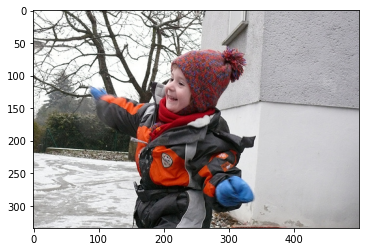

Real Caption: smiling boy in winter clothes waves his <unk> hands outside building in the snow
Prediction Caption: baby in winter gear holds
BLEU-1 score: 8.786571270524224
BLEU-2 score: 6.806048840200973
BLEU-3 score: 5.9199309684733726e-92
BLEU-4 score: 1.9979751932053748e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


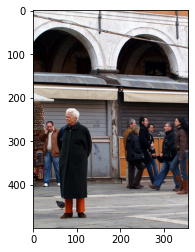

Real Caption: white haired man in black coat is standing on city street
Prediction Caption: an older man in long one man reading and people pass by sign or store
BLEU-1 score: 12.500000000000004
BLEU-2 score: 9.12870929175277
BLEU-3 score: 1.2035079283127572e-91
BLEU-4 score: 4.506889438070446e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


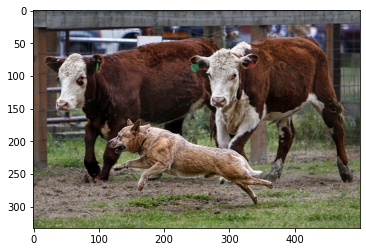

Real Caption: dog runs by two cows
Prediction Caption: two cows stand nearby while the sheep past plant
BLEU-1 score: 20.0
BLEU-2 score: 14.9071198499986
BLEU-3 score: 1.6152493512830776e-91
BLEU-4 score: 5.75929185611095e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


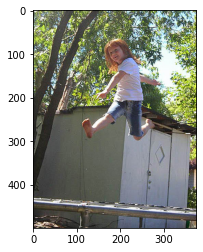

Real Caption: barefoot girl jumping over rail
Prediction Caption: little girl on swing
BLEU-1 score: 20.0
BLEU-2 score: 6.6709427497276e-153
BLEU-3 score: 1.5802130991274055e-183
BLEU-4 score: 1.2183324802375697e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


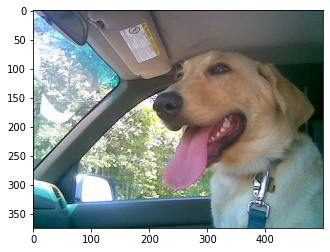

Real Caption: light colored dog with blue leash attached is sitting in vehicle
Prediction Caption: yellow board rides bus
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


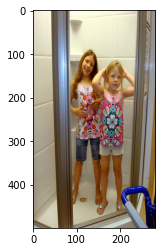

Real Caption: two girls in colourful clothes inside shower enclosure
Prediction Caption: two girls in shorts are standing inside shower stall
BLEU-1 score: 50.0
BLEU-2 score: 40.8248290463863
BLEU-3 score: 31.306003451477082
BLEU-4 score: 4.640083527732319e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


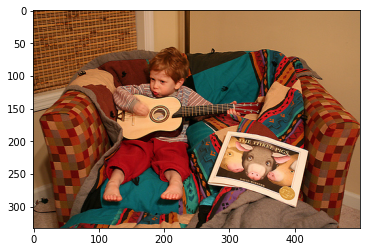

Real Caption: young child playing guitar on the chair
Prediction Caption: toddler is sitting on red checked chair whilst playing guitar
BLEU-1 score: 36.36363636363637
BLEU-2 score: 19.06925178491185
BLEU-3 score: 1.8724210775784561e-91
BLEU-4 score: 6.513869329968086e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


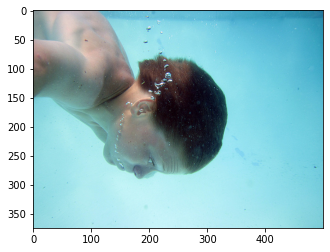

Real Caption: child holds his breath underwater
Prediction Caption: boy slides through deep water
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


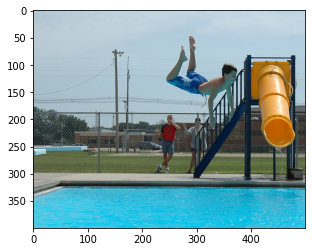

Real Caption: kid playing in swimming pool
Prediction Caption: boy is doing the male watches from diving board run into pool near water slide
BLEU-1 score: 6.25
BLEU-2 score: 3.7291703656001405e-153
BLEU-3 score: 1.1147325022884998e-183
BLEU-4 score: 9.10915994722721e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


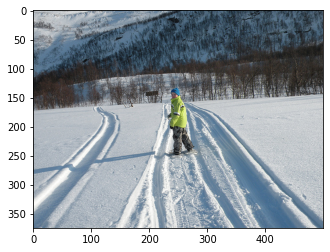

Real Caption: child walking in the snow
Prediction Caption: an older with red tent near mountain
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


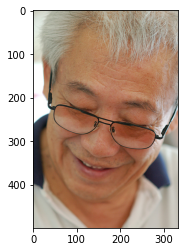

Real Caption: man wearing glasses looks down and smiles
Prediction Caption: dark haired man in an orange shirt
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


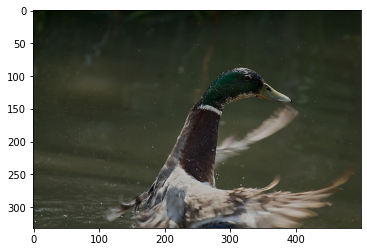

Real Caption: duck flapping wings
Prediction Caption: large mallard duck flies out is flying over the water
BLEU-1 score: 9.09090909090909
BLEU-2 score: 4.497548684366688e-153
BLEU-3 score: 1.2473514990254889e-183
BLEU-4 score: 1.0003688322288243e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


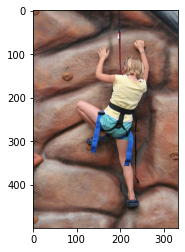

Real Caption: woman climbing an artificial rock wall
Prediction Caption: woman rides the side of huge wall whilst wearing shorts is rock wall
BLEU-1 score: 21.428571428571423
BLEU-2 score: 12.838814775327384
BLEU-3 score: 1.47678845808219e-91
BLEU-4 score: 5.344839673067705e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


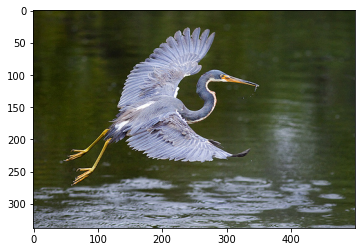

Real Caption: large bird spreading his wings in flight over body of water
Prediction Caption: blue bird flying over water
BLEU-1 score: 21.729910425353914
BLEU-2 score: 4.5840057067137364e-153
BLEU-3 score: 9.040357228341029e-184
BLEU-4 score: 6.657922819542466e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


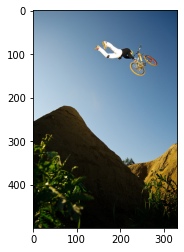

Real Caption: person in the air holding on to bicycle
Prediction Caption: biker flies through the background
BLEU-1 score: 11.942188509563156
BLEU-2 score: 4.3634676769543673e-153
BLEU-3 score: 1.072004124838459e-183
BLEU-4 score: 8.34076112986429e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


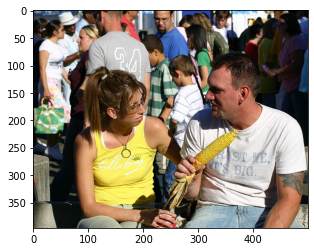

Real Caption: woman in yellow sitting next to man with cob of corn
Prediction Caption: man eats corn on the cob while talking to woman
BLEU-1 score: 45.45454545454545
BLEU-2 score: 1.0056824590358316e-152
BLEU-3 score: 2.0215284352902457e-183
BLEU-4 score: 1.4959003140449575e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


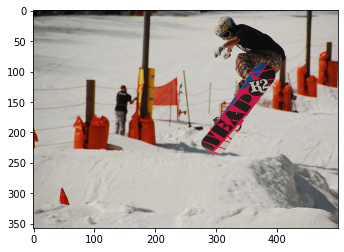

Real Caption: snowboarder doing jump on snowboard
Prediction Caption: person wearing protective gear on snowboard in the snow
BLEU-1 score: 20.0
BLEU-2 score: 14.9071198499986
BLEU-3 score: 1.6152493512830776e-91
BLEU-4 score: 5.75929185611095e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


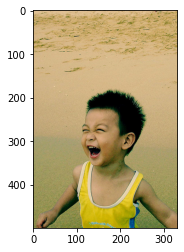

Real Caption: small boy in yellow shirt laughing on the beach
Prediction Caption: little boy with yellow shirt holds boogie body of water
BLEU-1 score: 27.27272727272727
BLEU-2 score: 16.514456476895408
BLEU-3 score: 1.7175994813661398e-91
BLEU-4 score: 6.061838450024688e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


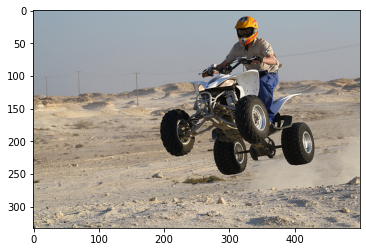

Real Caption: person rides in the air
Prediction Caption: the dirt biker in shorts and begins to get his motorcycle driving on sandy surface
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


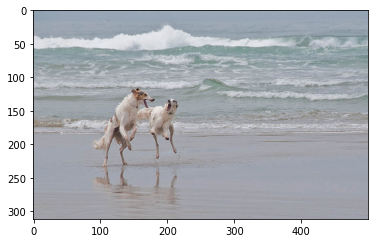

Real Caption: two white and brown dogs barking on the shoreline while waves roll in behind them
Prediction Caption: two dogs are jumping into the ocean
BLEU-1 score: 15.632325737944065
BLEU-2 score: 3.807853031210476e-153
BLEU-3 score: 7.954417236780597e-184
BLEU-4 score: 5.943037475387015e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


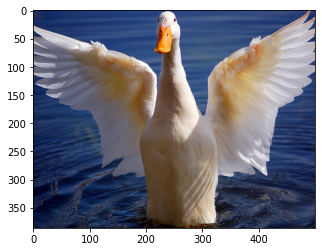

Real Caption: white duck is spreading its wings while sitting on the water
Prediction Caption: white duck spreads its wings
BLEU-1 score: 28.973213900471883
BLEU-2 score: 22.442554984526566
BLEU-3 score: 1.4793872820484318e-91
BLEU-4 score: 4.6585668346175364e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


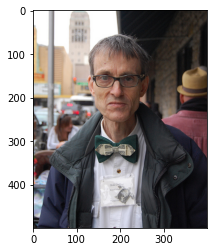

Real Caption: man with looks at the camera with no expression
Prediction Caption: an old man wearing big white shirt and glasses poses for photo
BLEU-1 score: 7.6923076923076925
BLEU-2 score: 4.1371430671115044e-153
BLEU-3 score: 1.1863795531178766e-183
BLEU-4 score: 9.594503055152631e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


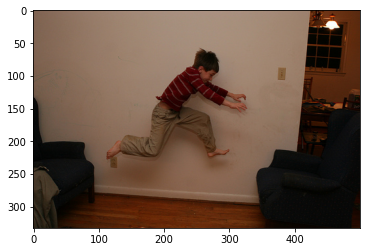

Real Caption: little boy jumping from one chair to another
Prediction Caption: young boy leaps from chair
BLEU-1 score: 35.826565528689464
BLEU-2 score: 7.55774771366971e-153
BLEU-3 score: 1.490502925709351e-183
BLEU-4 score: 1.0977058971259434e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


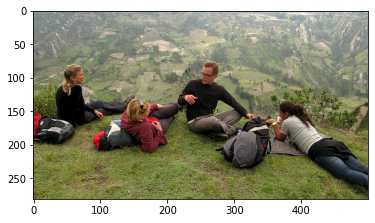

Real Caption: group of traveling people relaxing on top of hill overlooking range
Prediction Caption: four boys play at the top of hill
BLEU-1 score: 26.691246763893595
BLEU-2 score: 23.115297756211042
BLEU-3 score: 21.19367788247661
BLEU-4 score: 3.230400742863022e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


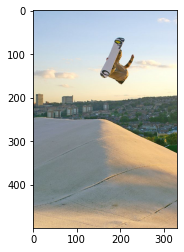

Real Caption: snowboarder is in midair doing trick
Prediction Caption: someone on snowboard as though guy in suit plays in the air on his board on his board on his board on his board on his board on his board on his
BLEU-1 score: 3.0303030303030303
BLEU-2 score: 2.5966609436124835e-153
BLEU-3 score: 8.971240035924835e-184
BLEU-4 score: 7.6011593754101815e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


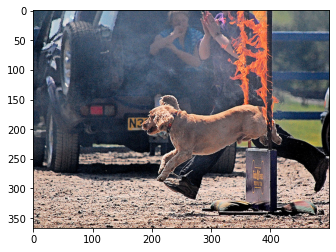

Real Caption: tan dog is jumping through fire hoop
Prediction Caption: light brown dog jumps through flaming hoop their ears into flaming hoop their back to catch green tricycle
BLEU-1 score: 15.789473684210522
BLEU-2 score: 5.927288177094464e-153
BLEU-3 score: 1.4720309963537117e-183
BLEU-4 score: 1.1484186507842884e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


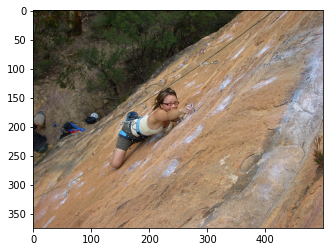

Real Caption: the woman in glasses is climbing steep rock wall
Prediction Caption: girl in brown hair is in brown is rock wall while rock face while rock face while rock face while rock face while rock face while rock face while rock face while
BLEU-1 score: 12.121212121212123
BLEU-2 score: 6.154574548966637
BLEU-3 score: 9.499968196054682e-92
BLEU-4 score: 3.7005922416742967e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


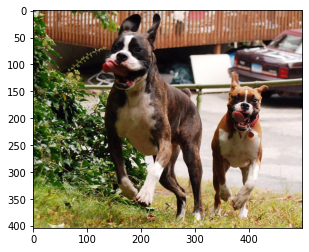

Real Caption: two brown and white dogs are next to each other with red toys in their mouths
Prediction Caption: two dogs running through grass carrying ball
BLEU-1 score: 9.196986029286059
BLEU-2 score: 2.743770220260171e-153
BLEU-3 score: 6.215759172786402e-184
BLEU-4 score: 4.739132419722992e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


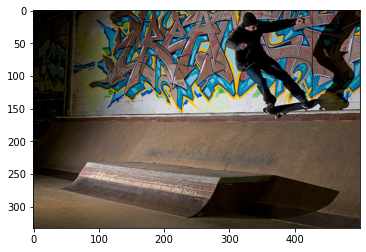

Real Caption: skateboarder is jumping through the air in front of graffiti covered wall
Prediction Caption: skateboarder is doing jump on wall covered with his shadow taking nap on ramp
BLEU-1 score: 26.666666666666668
BLEU-2 score: 13.801311186847082
BLEU-3 score: 1.5422526970585464e-91
BLEU-4 score: 5.541564466373977e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


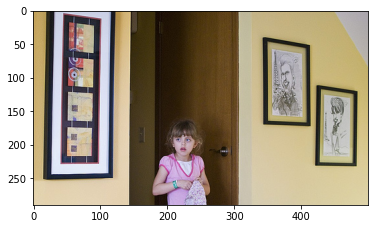

Real Caption: young girl standing alone in hallway
Prediction Caption: young girl in pink stands in an open door
BLEU-1 score: 30.0
BLEU-2 score: 18.257418583505533
BLEU-3 score: 1.8241769048702254e-91
BLEU-4 score: 6.373704167435468e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


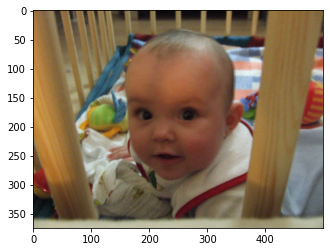

Real Caption: the infant is laying on its stomach in crib looking up at the camera
Prediction Caption: baby looks through the playpen with wide and holds camera with wide eyes
BLEU-1 score: 14.285714285714285
BLEU-2 score: 5.637975647982814e-153
BLEU-3 score: 1.4284901392909564e-183
BLEU-4 score: 1.1200407237786664e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


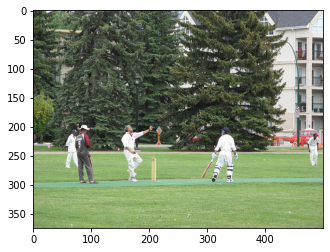

Real Caption: people playing cricket on field
Prediction Caption: some children are playing cricket kick for the soccer in the background
BLEU-1 score: 15.384615384615385
BLEU-2 score: 11.322770341445958
BLEU-3 score: 1.36954071726339e-91
BLEU-4 score: 5.019362538473706e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


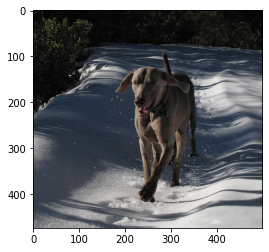

Real Caption: dog runs on snowy path
Prediction Caption: brown dog runs down path
BLEU-1 score: 50.0
BLEU-2 score: 31.6227766016838
BLEU-3 score: 2.536315813271983e-91
BLEU-4 score: 8.38826642100846e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


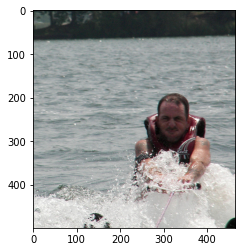

Real Caption: man waterskies
Prediction Caption: man plays on the side of the water
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


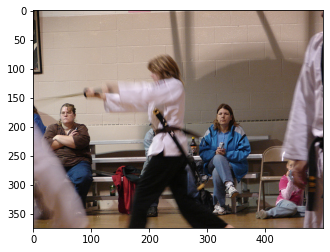

Real Caption: girl in white is swinging sword
Prediction Caption: two young children are wearing red and female teenagers are wearing red shirts one of those persons holding sword
BLEU-1 score: 5.000000000000001
BLEU-2 score: 3.335471374863794e-153
BLEU-3 score: 1.0425518425027685e-183
BLEU-4 score: 8.614911585158346e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


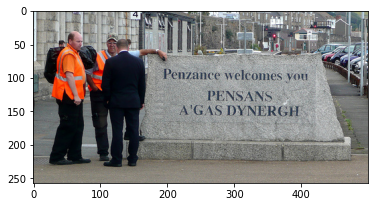

Real Caption: these men are standing next to penzance <unk> you stone
Prediction Caption: man and two men in winter clothes are standing beside
BLEU-1 score: 27.27272727272727
BLEU-2 score: 16.514456476895408
BLEU-3 score: 1.7175994813661398e-91
BLEU-4 score: 6.061838450024688e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


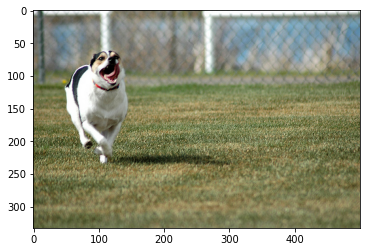

Real Caption: white dog is running with its mouth open across the grass
Prediction Caption: dog runs across the grass
BLEU-1 score: 28.973213900471883
BLEU-2 score: 22.442554984526566
BLEU-3 score: 19.286816745371354
BLEU-4 score: 2.6971259331602326e-76
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


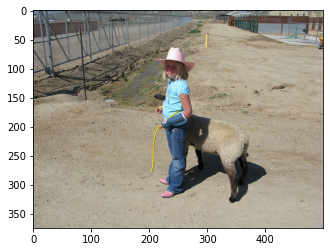

Real Caption: little girl in pink cowgirl hat and blue cast over her arm is walking sheep
Prediction Caption: girl wearing pink sweater with sheep on ground
BLEU-1 score: 17.113903967753068
BLEU-2 score: 4.421625271317475e-153
BLEU-3 score: 9.45672212180377e-184
BLEU-4 score: 7.107197028258988e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


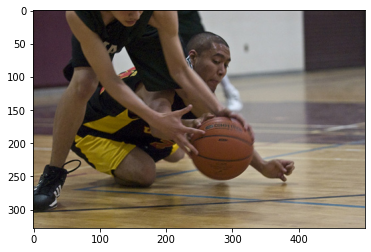

Real Caption: two high school basketball players reach to grab the ball one falling to the floor
Prediction Caption: two basketball basketball basketball
BLEU-1 score: 5.413411329464508
BLEU-2 score: 1.2767716991409542e-153
BLEU-3 score: 2.6329080505515765e-184
BLEU-4 score: 1.9608047828287652e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


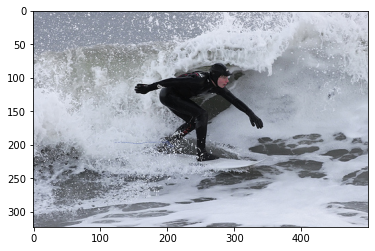

Real Caption: surfer rides the waves
Prediction Caption: person in black is surfing in the ocean with wave coming down
BLEU-1 score: 7.6923076923076925
BLEU-2 score: 4.1371430671115044e-153
BLEU-3 score: 1.1863795531178766e-183
BLEU-4 score: 9.594503055152631e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


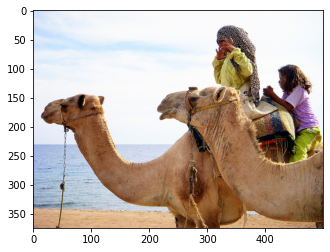

Real Caption: people ride two camels at the beach
Prediction Caption: two camels ride camel by water
BLEU-1 score: 42.857142857142854
BLEU-2 score: 26.726124191242434
BLEU-3 score: 2.2927933779232266e-91
BLEU-4 score: 7.711523862191632e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


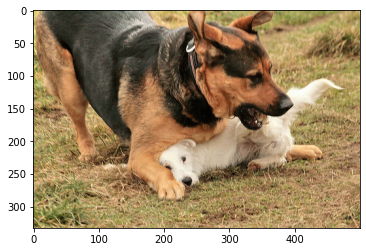

Real Caption: the big brown and black dog is on top of small white dog
Prediction Caption: the brown and white dog are playing
BLEU-1 score: 33.453839282436896
BLEU-2 score: 22.618923685244415
BLEU-3 score: 1.6155219760581522e-91
BLEU-4 score: 5.190284426706259e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


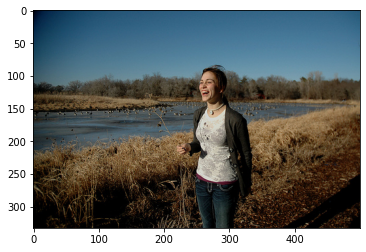

Real Caption: smiling woman stands in front of body of water with water birds
Prediction Caption: the smiling woman stands in grass near creek
BLEU-1 score: 31.845836025501743
BLEU-2 score: 29.25226826055808
BLEU-3 score: 28.745468037445242
BLEU-4 score: 21.386638885976573
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


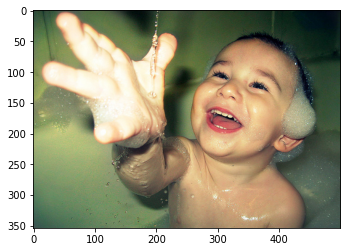

Real Caption: the toddler is splashing water in the tub with suds all over
Prediction Caption: small boy is smiling at the camera
BLEU-1 score: 15.163266492815836
BLEU-2 score: 4.5237123240565193e-153
BLEU-3 score: 1.0248054361722373e-183
BLEU-4 score: 7.813508425061864e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


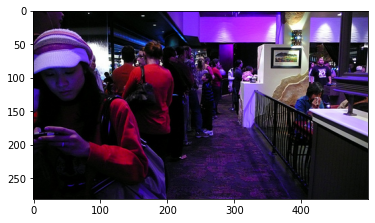

Real Caption: inside bar there are people with red shirts
Prediction Caption: many people are on the other people that dressed in purple room with their very large black very large black very large black very large black very large black very large black
BLEU-1 score: 9.09090909090909
BLEU-2 score: 4.497548684366688e-153
BLEU-3 score: 1.2473514990254889e-183
BLEU-4 score: 1.0003688322288243e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


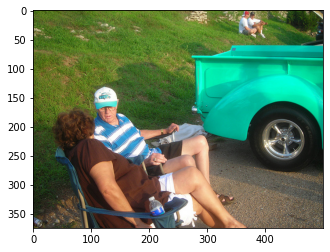

Real Caption: an older couple chats near bright colored car
Prediction Caption: two people gathered outdoors next to truck
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


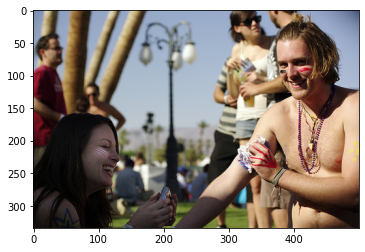

Real Caption: the people have paint on them
Prediction Caption: shirtless man in woman wearing all wearing except paint and laughing
BLEU-1 score: 8.333333333333332
BLEU-2 score: 4.306075028866568e-153
BLEU-3 score: 1.2152126591739945e-183
BLEU-4 score: 9.788429383461836e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


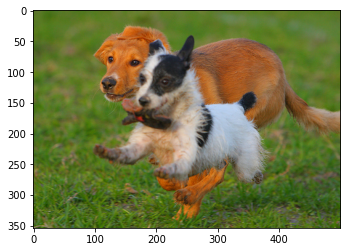

Real Caption: two dogs are running together through the grass
Prediction Caption: two brown dog with black patches are walking on the grass
BLEU-1 score: 33.33333333333333
BLEU-2 score: 17.407765595569778
BLEU-3 score: 1.7727567490939188e-91
BLEU-4 score: 6.223629500679345e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


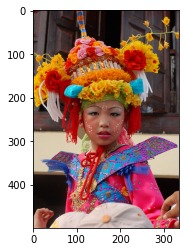

Real Caption: girl in colorful clothes and hat posing for the camera
Prediction Caption: an asian girl is dressed in colorful costume
BLEU-1 score: 29.827977227145652
BLEU-2 score: 18.26583106646588
BLEU-3 score: 1.745359983331643e-91
BLEU-4 score: 6.030654703641958e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


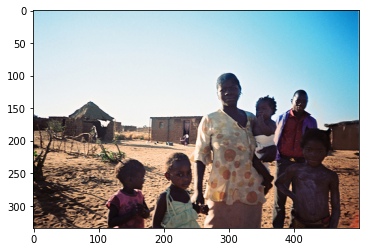

Real Caption: family standing in small village
Prediction Caption: black mother and five children in rural area
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


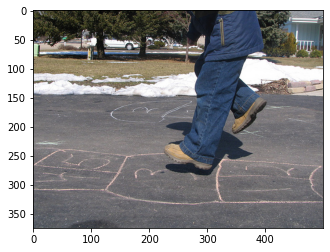

Real Caption: someone is playing hopscotch on <unk> out <unk> on the ground
Prediction Caption: closeup of pair of feet in mid jump while playing hopscotch
BLEU-1 score: 16.666666666666668
BLEU-2 score: 12.309149097933275
BLEU-3 score: 1.4399259176082162e-91
BLEU-4 score: 5.233427736988301e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


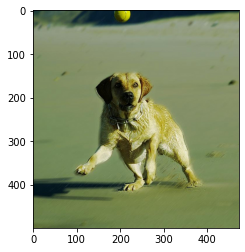

Real Caption: dog gets ready to catch yellow ball while standing in the sand
Prediction Caption: yellow dog looks on the beach
BLEU-1 score: 20.980356838155135
BLEU-2 score: 4.780501720609066e-153
BLEU-3 score: 9.723067014109315e-184
BLEU-4 score: 7.2161206040200775e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


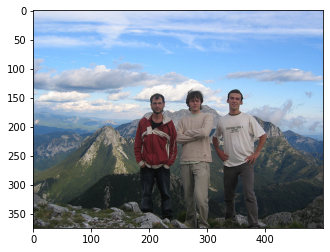

Real Caption: these three young men are standing on mountaintop
Prediction Caption: three men pose on mountain
BLEU-1 score: 35.826565528689464
BLEU-2 score: 7.55774771366971e-153
BLEU-3 score: 1.490502925709351e-183
BLEU-4 score: 1.0977058971259434e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


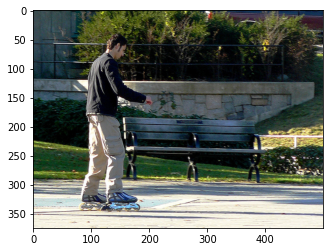

Real Caption: man is inline skating in front of wooden bench
Prediction Caption: man in black shirt is rollerblading past bench in the city
BLEU-1 score: 33.33333333333333
BLEU-2 score: 8.612150057732662e-153
BLEU-3 score: 1.8419179593432007e-183
BLEU-4 score: 1.384292958842266e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


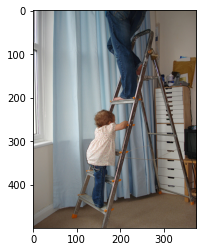

Real Caption: person stands at the top of ladder as young girl begins to climb
Prediction Caption: little girl climbs ladder
BLEU-1 score: 8.075860719786215
BLEU-2 score: 1.9047195540278845e-153
BLEU-3 score: 3.927837256431372e-184
BLEU-4 score: 2.925177002277079e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


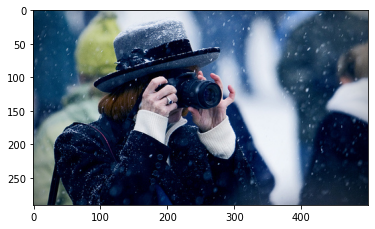

Real Caption: woman takes picture as it snows
Prediction Caption: person wearing blue jacket and furry hat
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


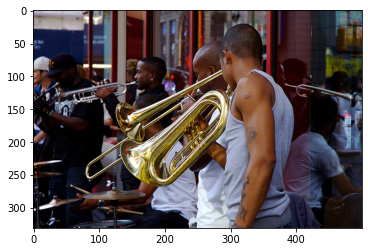

Real Caption: group of men playing brass instruments
Prediction Caption: band playing game
BLEU-1 score: 15.163266492815836
BLEU-2 score: 4.5237123240565193e-153
BLEU-3 score: 1.0248054361722373e-183
BLEU-4 score: 7.813508425061864e-230
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


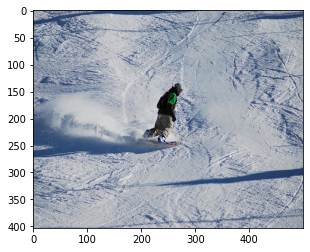

Real Caption: the man is snowboarding down snowy hill
Prediction Caption: snowboarder is coming down mountain
BLEU-1 score: 28.2160574963538
BLEU-2 score: 7.290027635886345e-153
BLEU-3 score: 1.5591498913318324e-183
BLEU-4 score: 1.171778691554733e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


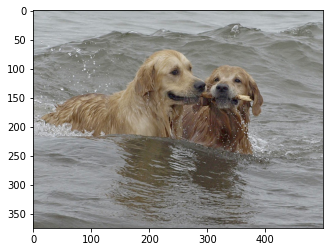

Real Caption: two dogs in the surf holding on to the same stick
Prediction Caption: two dogs are in the water retrieving stick in the water retrieving stick in the water retrieving stick in the water retrieving stick in the water retrieving stick in the water retrieving
BLEU-1 score: 18.181818181818183
BLEU-2 score: 10.66003581778052
BLEU-3 score: 1.3208652898140134e-91
BLEU-4 score: 4.870253281801217e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


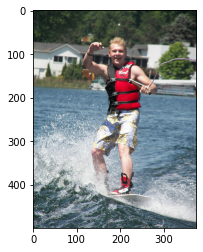

Real Caption: man wearing red life vest waves as he <unk>
Prediction Caption: guy wakeboarding one handed and smiling
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


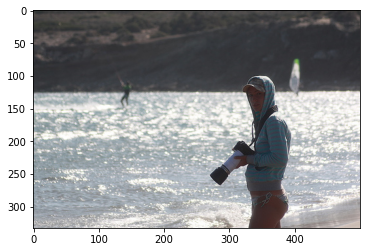

Real Caption: woman with hooded sweatshirt and bikini bottoms holding camera at beach side
Prediction Caption: woman walking is walking is walking is walking is carrying surfboard and fishing pole and the water
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


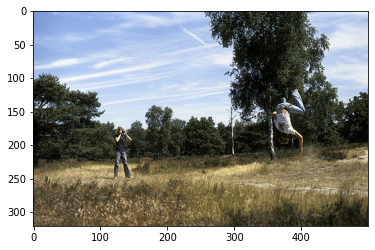

Real Caption: one person does flip in the middle of the field while their friend takes picture
Prediction Caption: person is taking picture of another person doing flip in midair in the grass
BLEU-1 score: 40.0
BLEU-2 score: 23.90457218668787
BLEU-3 score: 2.1443314478806674e-91
BLEU-4 score: 7.293108985295422e-153
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


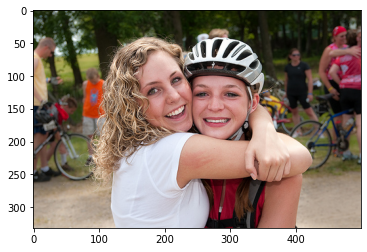

Real Caption: girl cyclist being hugged by another girl
Prediction Caption: two girls hugging
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Shape before preprocess: (224, 224, 3)
Shape after preprocess: (224, 224, 3)


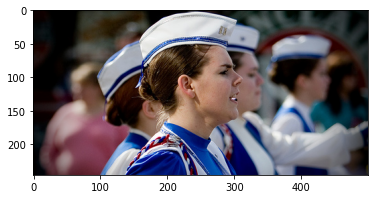

Real Caption: young woman with white and blue hat and uniform yells to others dressed the same
Prediction Caption: girl wears blue hat with white and blue hat with hat on their head wrap is wearing red hat with her hat is wearing red hat with her hat is wearing red
BLEU-1 score: 15.151515151515154
BLEU-2 score: 13.76204706407951
BLEU-3 score: 15.098635175831415
BLEU-4 score: 10.51377297031591
BLEU-1 count: 178
BLEU-2 count: 89
BLEU-3 count: 35
BLEU-4 count: 14
BLEU-1 Total: 49.37667514877779
BLEU-2 Total: 22.267016252787997
BLEU-3 Total: 10.155341038574429
BLEU-4 Total: 3.651634702678371
BLEU-1 Average: 0.27739705139762805
BLEU-2 Average: 0.25019119385155053
BLEU-3 Average: 0.29015260110212654
BLEU-4 Average: 0.2608310501913122
Real Caption: young woman with white and blue hat and uniform yells to others dressed the same
Prediction Caption: girl wears blue hat with white and blue hat with hat on their head wrap is wearing red hat with her hat is wearing red hat with her hat is wearing 

In [ ]:
blue_1 = 0
blue_2 = 0
blue_3 = 0
blue_4 = 0
blue_count_1 = 0
blue_count_2 = 0
blue_count_3 = 0
blue_count_4 = 0
for j in range(250):    
    rid = np.random.randint(0, len(img_name_val))
    image = img_name_val[rid]

    real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
    result, attention_plot = evaluate(image)

    # remove <start> and <end> from the real_caption
    first = real_caption.split(' ', 1)[1]
    real_caption = first.rsplit(' ', 1)[0]
    temp_image = np.array(Image.open(image))
    plt.imshow(temp_image)
    plt.show()
    #Image.open(img_name_val[rid])
    #remove "<unk>" in result
    for i in result:
        if i=="<unk>":
            result.remove(i)

    for i in real_caption:
        if i=="<unk>":
            real_caption.remove(i)

    #remove <end> from result        
    result_join = ' '.join(result)
    result_final = result_join.rsplit(' ', 1)[0]

    real_appn = []
    real_appn.append(real_caption.split())
    reference = real_appn
    candidate = result
    print ('Real Caption:', real_caption)
    print ('Prediction Caption:', result_final)
    score = sentence_bleu(reference, candidate, weights=(1.0,0,0,0))
    if score > 0.1:
        blue_1 +=score
        blue_count_1 +=1
    print(f"BLEU-1 score: {score*100}")
    score = sentence_bleu(reference, candidate, weights=(0.5,0.5,0,0))
    if score > 0.1:
        blue_2 +=score
        blue_count_2 +=1
    print(f"BLEU-2 score: {score*100}")
    score = sentence_bleu(reference, candidate, weights=(0.3,0.3,0.3,0))
    if score > 0.1:
        blue_3 +=score
        blue_count_3 += 1
    print(f"BLEU-3 score: {score*100}")
    score = sentence_bleu(reference, candidate, weights=(0.25,0.25,0.25,0.25))
    if score > 0.1:
        blue_4 +=score
        blue_count_4 += 1
    print(f"BLEU-4 score: {score*100}")

print(f"BLEU-1 count: {blue_count_1}")
print(f"BLEU-2 count: {blue_count_2}")
print(f"BLEU-3 count: {blue_count_3}")
print(f"BLEU-4 count: {blue_count_4}")
print(f"BLEU-1 Total: {blue_1}")
print(f"BLEU-2 Total: {blue_2}")
print(f"BLEU-3 Total: {blue_3}")
print(f"BLEU-4 Total: {blue_4}")
if blue_count_1 > 0:
    print(f"BLEU-1 Average: {blue_1/blue_count_1}")
if blue_count_2 > 0:
    print(f"BLEU-2 Average: {blue_2/blue_count_2}")
if blue_count_3 > 0:
    print(f"BLEU-3 Average: {blue_3/blue_count_3}")
if blue_count_4 > 0:
    print(f"BLEU-4 Average: {blue_4/blue_count_4}")

    print ('Real Caption:', real_caption)
    print ('Prediction Caption:', result_final)

    #plot_attention(image, result, attention_plot)
if blue_count_1 > 0:
    print("Blue score count > 0.1",blue_count_1)
    print("Blue score average >0.1",blue_1/blue_count_1)

In [ ]:
#-------------------END------------------------